<a href="https://colab.research.google.com/github/Crumpetlee/instagram_emotion_tagger/blob/combined/mtcnn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!unzip people_images.zip

Streaming output truncated to the last 5000 lines.
  inflating: train/image_data/13198.jpg  
  inflating: train/image_data/13199.jpg  
  inflating: train/image_data/13200.jpg  
  inflating: train/image_data/13201.jpg  
  inflating: train/image_data/13202.jpg  
  inflating: train/image_data/13203.jpg  
  inflating: train/image_data/13204.jpg  
  inflating: train/image_data/13205.jpg  
  inflating: train/image_data/13206.jpg  
  inflating: train/image_data/13207.jpg  
  inflating: train/image_data/13208.jpg  
  inflating: train/image_data/13209.jpg  
  inflating: train/image_data/13210.jpg  
  inflating: train/image_data/13211.jpg  
  inflating: train/image_data/13212.jpg  
  inflating: train/image_data/13213.jpg  
  inflating: train/image_data/13214.jpg  
  inflating: train/image_data/13215.jpg  
  inflating: train/image_data/13216.jpg  
  inflating: train/image_data/13217.jpg  
  inflating: train/image_data/13218.jpg  
  inflating: train/image_data/13219.jpg  
  inflating: train/image_

In [1]:
!unzip my_model\ \(2\).zip

Streaming output truncated to the last 5000 lines.
 extracting: dataset/happy/Training_72595222.jpg  
 extracting: dataset/happy/Training_66010312.jpg  
 extracting: dataset/happy/Training_30272392.jpg  
 extracting: dataset/happy/Training_42838886.jpg  
 extracting: dataset/happy/Training_98980622.jpg  
 extracting: dataset/happy/Training_38262419.jpg  
 extracting: dataset/happy/Training_27392651.jpg  
 extracting: dataset/happy/Training_26913883.jpg  
 extracting: dataset/happy/Training_80773404.jpg  
 extracting: dataset/happy/Training_48655070.jpg  
 extracting: dataset/happy/Training_20903654.jpg  
 extracting: dataset/happy/Training_59882031.jpg  
 extracting: dataset/happy/Training_53435548.jpg  
 extracting: dataset/happy/Training_89361519.jpg  
 extracting: dataset/happy/Training_72830293.jpg  
 extracting: dataset/happy/Training_3860263.jpg  
 extracting: dataset/happy/Training_50979726.jpg  
 extracting: dataset/happy/Training_44849778.jpg  
 extracting: dataset/happy/Train

In [2]:
!pip install mtcnn
!pip install scikit-plot
!pip install tensorflow

from matplotlib import pyplot
from matplotlib.patches import Rectangle
from matplotlib.patches import Circle
import matplotlib.image as mpimg
import tensorflow
import pandas as pd
import cv2 
import scikitplot.metrics
from PIL import Image
import torch
import time
import glob
from tqdm.notebook import tqdm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.3 MB 17.4 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
#load saved model
loaded_model = tensorflow.keras.models.load_model('saved_model/my_model')


In [4]:
#!pip install mtcnn
# draw an image with detected objects
def draw_image_with_boxes(filename, result_list):
 # load the image
 data = pyplot.imread(filename)
 # plot the image
 pyplot.imshow(data)
 # get the context for drawing boxes
 ax = pyplot.gca()
 # plot each box
 for result in result_list:
 # get coordinates
  x, y, width, height = result['box']
 # create the shape
  rect = Rectangle((x, y), width, height, fill=False, color='red')
 # draw the box
  ax.add_patch(rect)
 # draw the dots
  for key, value in result['keypoints'].items():
  # create and draw dot
    dot = Circle(value, radius=2, color='red')
    ax.add_patch(dot)
 # show the plot
 pyplot.show()

from mtcnn import MTCNN

def detect_faces(imagePath, actual):
  # create the detector, using default weights
  pixels = pyplot.imread(imagePath)
  if(len(pixels.shape) < 3):
    pixels = cv2.cvtColor(pixels, cv2.COLOR_GRAY2RGB)

  detector = MTCNN()
  faces = detector.detect_faces(pixels)

  #bounding_boxes, landmarks = detect_faces(pixels, minsize = 50, thresholds = [0.7, 0.8, 0.95])
  #bounding_boxes, landmarks = detect_faces(img, min_face_size = 50, thresholds = [0.7, 0.8, 0.95])

  indices = []
  for i in range(len(faces)):
    if faces[i]['confidence'] < 0.95:
      indices.append(i)

  faces = np.delete(faces, indices)
  predicted_count = len(faces)
  #print(data['HeadCount'], predicted_count)
  print("actual", actual, "predicted:", predicted_count)

  face_frames = [(x['box'][0], x['box'][1],
                    x['box'][2], x['box'][3]) for x in faces]

  images = []
  for (x, y, w, h) in face_frames:
    image = cv2.imread(imagePath)
    cv2.rectangle(image, (x, y), (x + w, y + h), (255, 255, 255), 2)
    roi_color = image[y:y + h, x:x + w]
    #saving photo
    name = str(w) + str(h) + '_faces.jpg'
    cv2.imwrite(name, roi_color)
    images.append(name)
    pic = pyplot.imread(name)
    # plot the image
    pyplot.imshow(pic)
    pyplot.show()

    
  #bounding_boxes = list(map(int, bounding_boxes[0]))
  
  
  draw_image_with_boxes(imagePath, faces)
  error = (actual - predicted_count)**2
  return predicted_count, error, images


In [5]:
def get_acc(predicted, actual):
  correct = 0
  for i in range(len(predicted)):
    if predicted[i] == actual[i]:
      correct += 1

  accuracy = correct / len(predicted)
  return accuracy

In [ ]:
import numpy as np
def main(data, imagesPath):
  predicted = []
  error_sum = []

  size = data.shape[0]
  
  for i in range(size):
    imagePath = imagesPath + data['Name'][i]
    # load image from file
    predicted_count, error, images = detect_faces(imagePath, data['HeadCount'][i])
    predicted.append(predicted_count)
    error_sum.append(error)
    
  metric = np.sum(error) / size
  accuracy = get_acc(predicted, data['HeadCount'])
  return metric, accuracy, predicted

data =pd.read_csv('train/train.csv')
metric, accuracy, predicted = main(data, 'train/image_data/')
print(metric, accuracy)


1/1 [==============================] - 0s 121ms/step
actual 4 predicted: 4
2/2 [==============================] - 0s 7ms/step
actual 4 predicted: 4
1/1 [==============================] - 0s 132ms/step
actual 2 predicted: 1
1/1 [==============================] - 0s 118ms/step
actual 3 predicted: 3
1/1 [==============================] - 0s 121ms/step
actual 4 predicted: 4
1/1 [==============================] - 0s 143ms/step
actual 4 predicted: 4
2/2 [==============================] - 0s 7ms/step
actual 6 predicted: 4
1/1 [==============================] - 0s 137ms/step
actual 7 predicted: 5
2/2 [==============================] - 0s 8ms/step
actual 6 predicted: 6
2/2 [==============================] - 0s 9ms/step
actual 8 predicted: 5
0.9 0.6


1/1 [==============================] - 0s 129ms/step
actual 4 predicted: 4


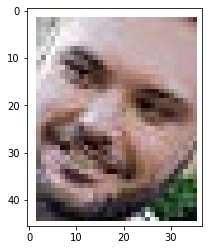

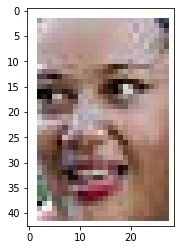

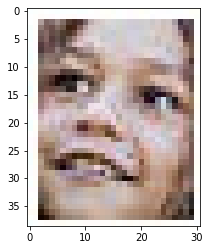

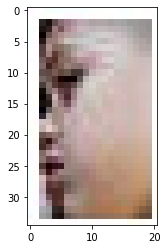

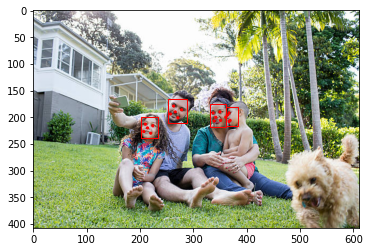

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [3]
[2, 2, 2, 3]
Dominant emotion:  2
2/2 [==============================] - 0s 10ms/step
actual 4 predicted: 4


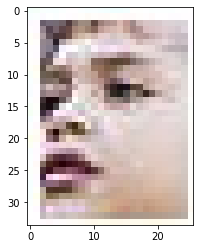

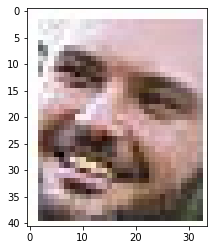

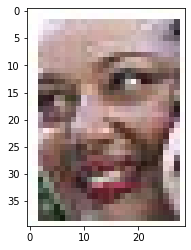

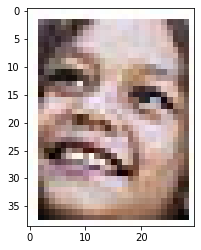

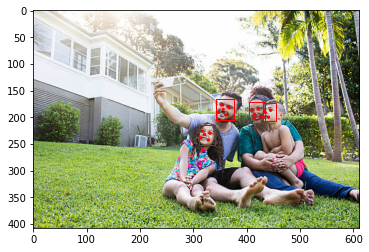

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [0]
Face  3 emotion [2]
[2, 2, 0, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 126ms/step
actual 2 predicted: 1


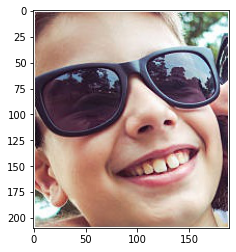

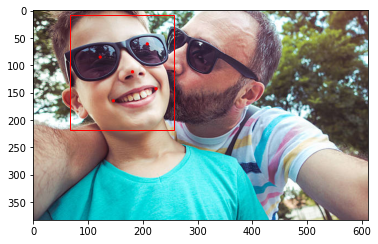

Face  0 emotion [2]
[2]
Dominant emotion:  2
1/1 [==============================] - 0s 129ms/step
actual 3 predicted: 3


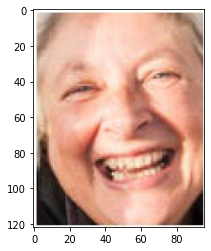

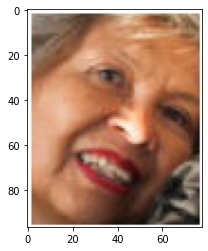

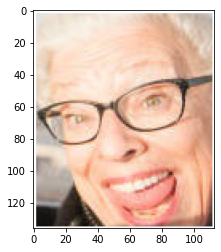

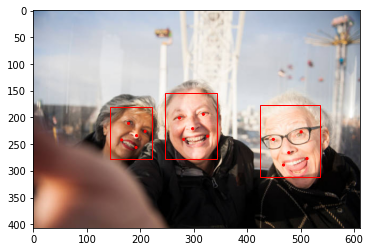

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
[2, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 120ms/step
actual 4 predicted: 4


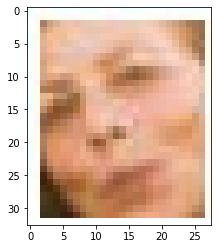

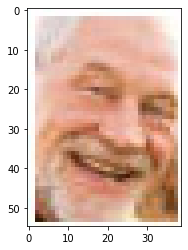

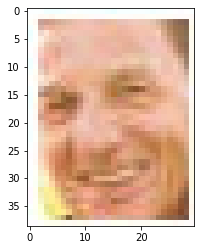

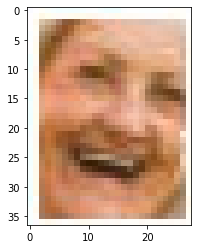

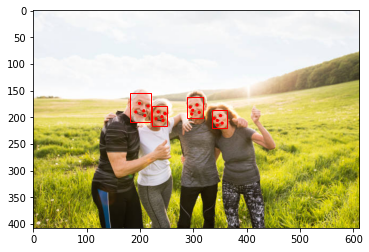

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [2]
[2, 2, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 124ms/step
actual 4 predicted: 4


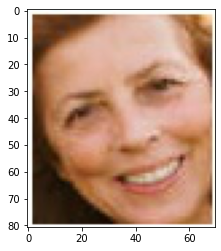

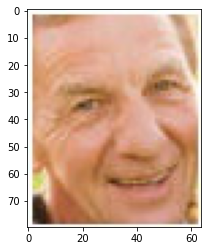

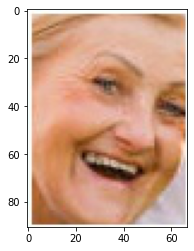

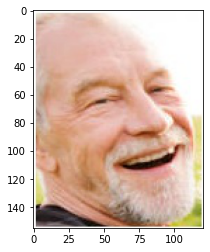

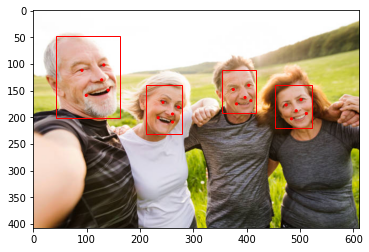

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [2]
[2, 2, 2, 2]
Dominant emotion:  2
2/2 [==============================] - 0s 14ms/step
actual 6 predicted: 4


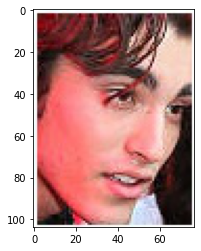

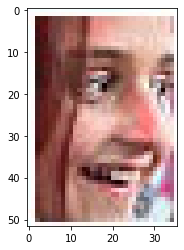

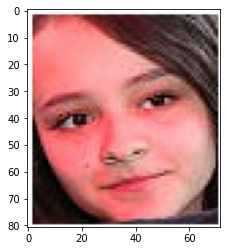

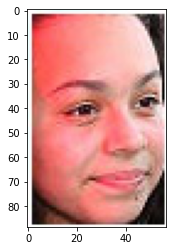

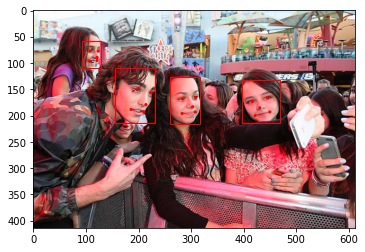

Face  0 emotion [2]
Face  1 emotion [0]
Face  2 emotion [2]
Face  3 emotion [2]
[2, 0, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 121ms/step
actual 7 predicted: 5


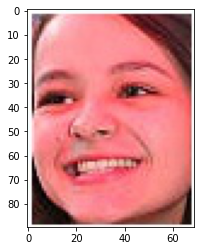

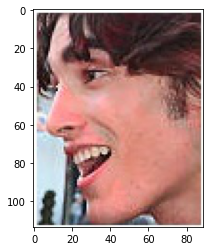

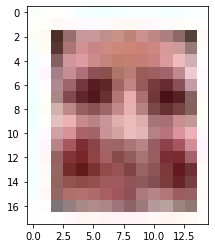

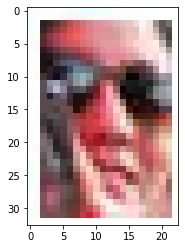

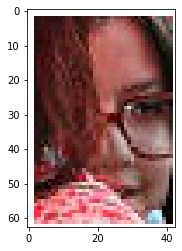

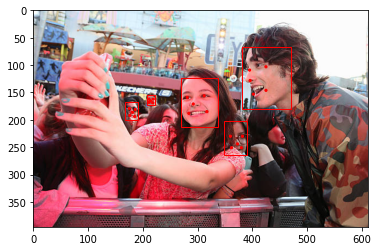

Face  0 emotion [2]
Face  1 emotion [0]
Face  2 emotion [3]
Face  3 emotion [0]
Face  4 emotion [3]
[2, 0, 3, 0, 3]
Dominant emotion:  0
2/2 [==============================] - 0s 9ms/step
actual 6 predicted: 6


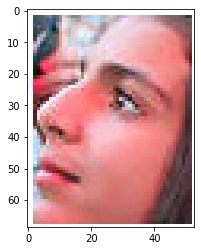

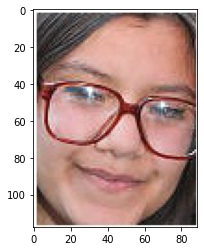

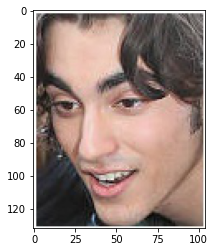

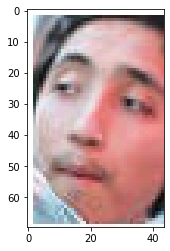

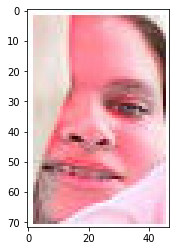

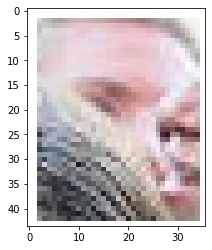

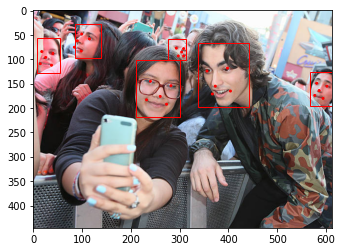

Face  0 emotion [3]
Face  1 emotion [3]
Face  2 emotion [0]
Face  3 emotion [2]
Face  4 emotion [2]
Face  5 emotion [3]
[3, 3, 0, 2, 2, 3]
Dominant emotion:  3
2/2 [==============================] - 0s 10ms/step
actual 8 predicted: 5


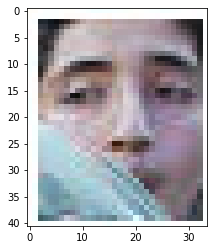

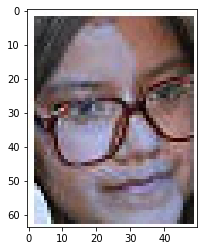

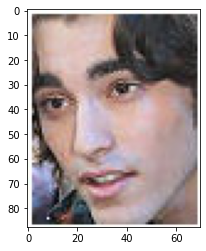

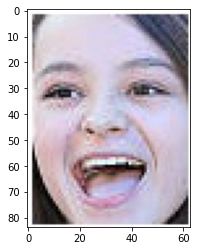

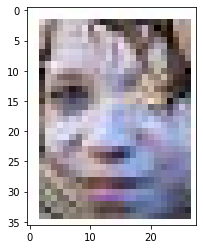

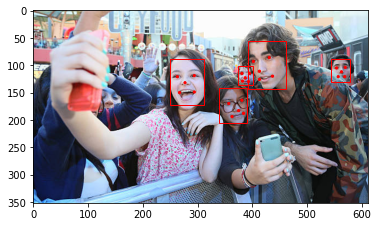

Face  0 emotion [3]
Face  1 emotion [2]
Face  2 emotion [0]
Face  3 emotion [2]
Face  4 emotion [3]
[3, 2, 0, 2, 3]
Dominant emotion:  3
1/1 [==============================] - 0s 130ms/step
actual 4 predicted: 2


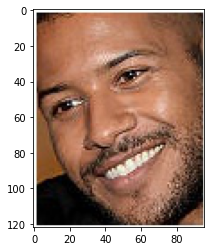

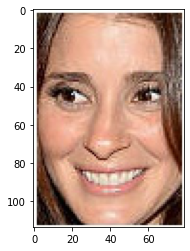

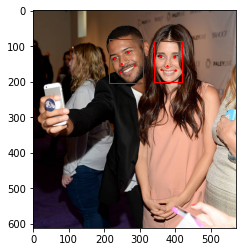

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
2/2 [==============================] - 0s 9ms/step
actual 7 predicted: 7


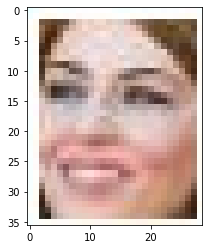

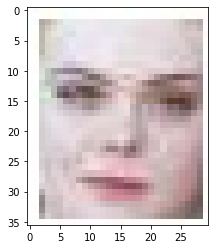

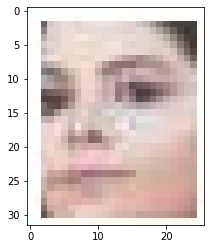

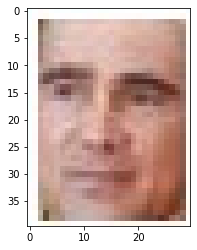

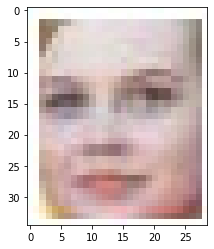

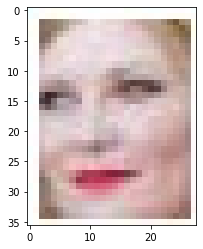

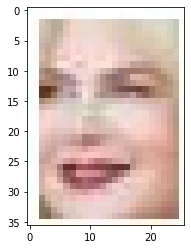

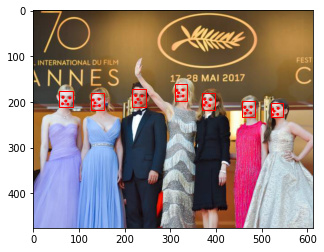

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [2]
Face  4 emotion [2]
Face  5 emotion [2]
Face  6 emotion [2]
[2, 2, 2, 2, 2, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 143ms/step
actual 2 predicted: 2


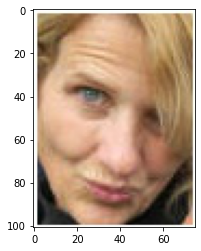

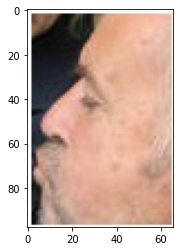

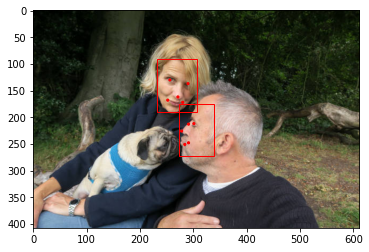

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 185ms/step
actual 3 predicted: 0


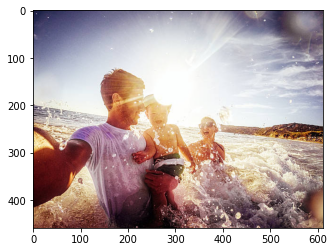

[]
No dominant emotion
1/1 [==============================] - 0s 178ms/step
actual 4 predicted: 3


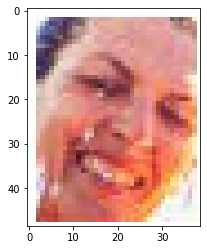

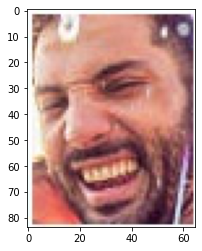

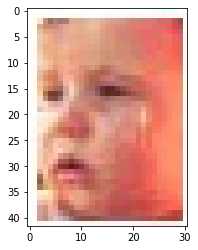

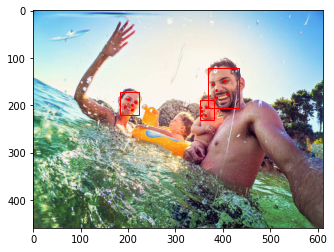

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [3]
[2, 2, 3]
Dominant emotion:  2
1/1 [==============================] - 0s 190ms/step
actual 2 predicted: 2


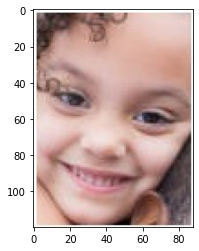

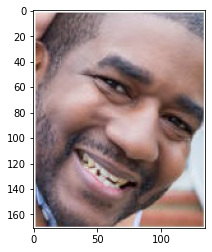

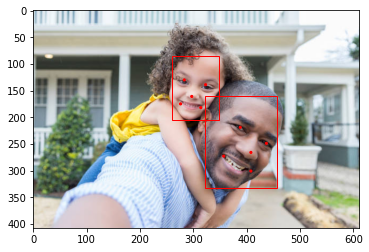

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
2/2 [==============================] - 0s 9ms/step
actual 4 predicted: 4


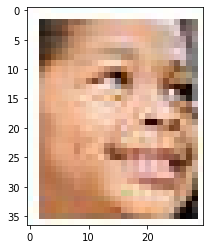

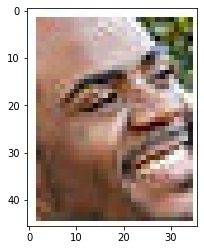

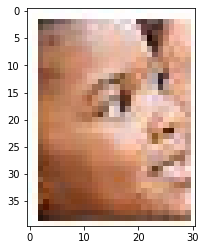

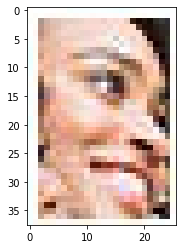

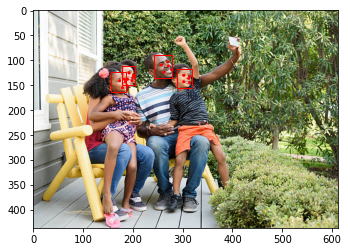

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [0]
[2, 2, 2, 0]
Dominant emotion:  2
1/1 [==============================] - 0s 186ms/step
actual 3 predicted: 3


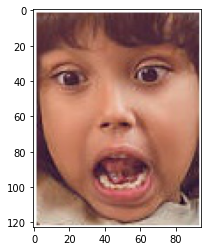

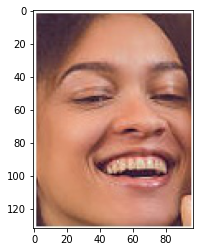

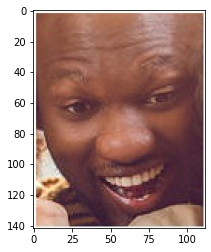

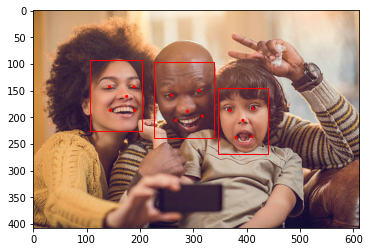

Face  0 emotion [0]
Face  1 emotion [2]
Face  2 emotion [2]
[0, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 176ms/step
actual 2 predicted: 2


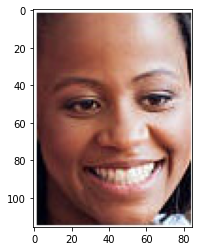

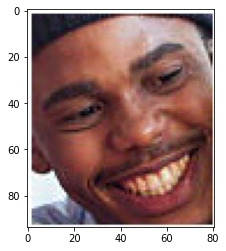

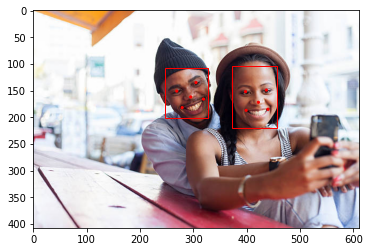

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
2/2 [==============================] - 0s 8ms/step
actual 6 predicted: 0


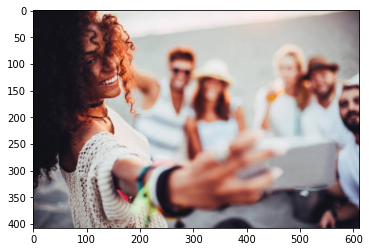

[]
No dominant emotion
1/1 [==============================] - 0s 187ms/step
actual 3 predicted: 3


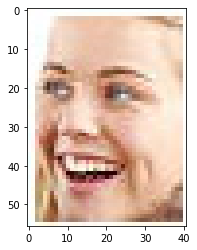

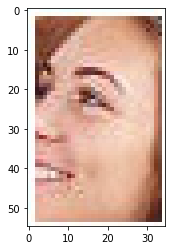

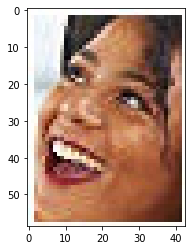

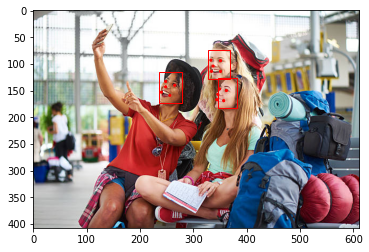

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
[2, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 178ms/step
actual 4 predicted: 4


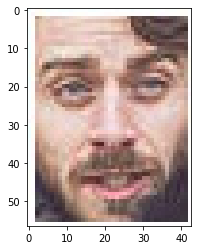

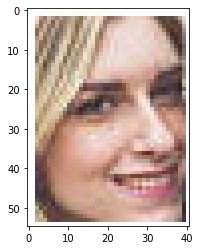

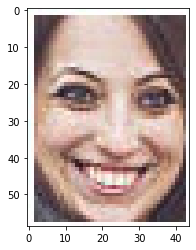

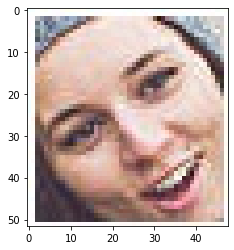

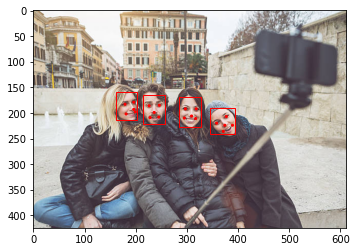

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [2]
[2, 2, 2, 2]
Dominant emotion:  2
2/2 [==============================] - 0s 10ms/step
actual 4 predicted: 3


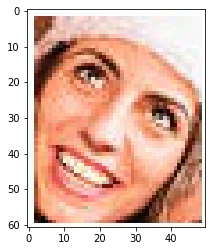

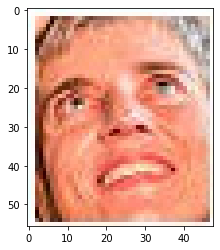

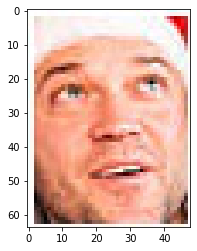

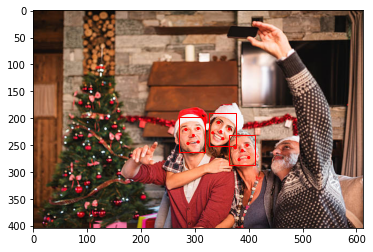

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [1]
[2, 2, 1]
Dominant emotion:  2
2/2 [==============================] - 0s 10ms/step
actual 4 predicted: 3


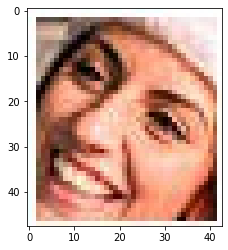

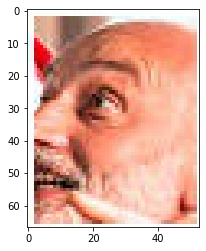

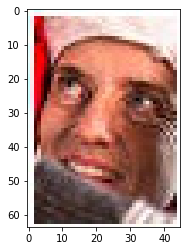

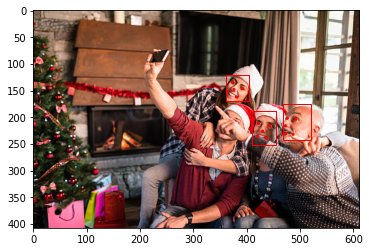

Face  0 emotion [2]
Face  1 emotion [3]
Face  2 emotion [3]
[2, 3, 3]
Dominant emotion:  3
2/2 [==============================] - 0s 7ms/step
actual 4 predicted: 4


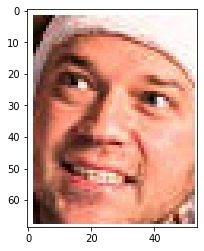

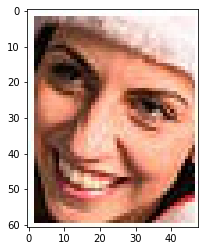

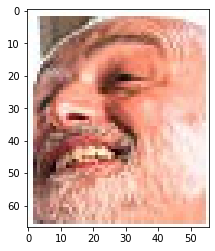

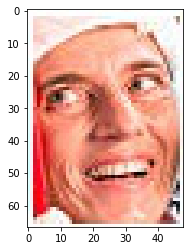

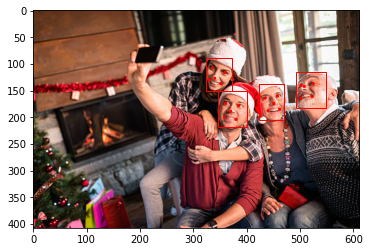

Face  0 emotion [3]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [0]
[3, 2, 2, 0]
Dominant emotion:  2
2/2 [==============================] - 0s 8ms/step
actual 7 predicted: 7


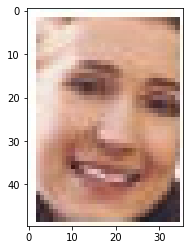

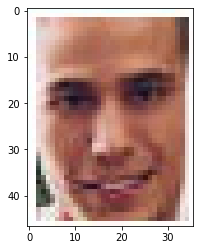

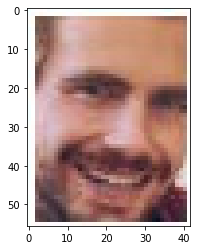

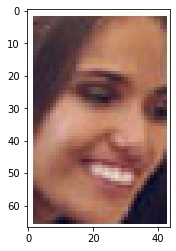

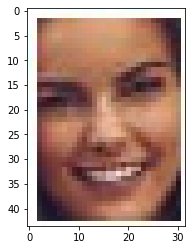

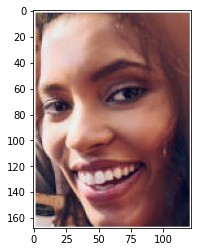

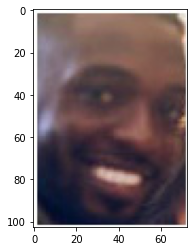

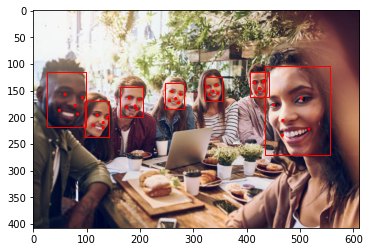

Face  0 emotion [2]
Face  1 emotion [3]
Face  2 emotion [2]
Face  3 emotion [2]
Face  4 emotion [2]
Face  5 emotion [2]
Face  6 emotion [2]
[2, 3, 2, 2, 2, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 183ms/step
actual 5 predicted: 5


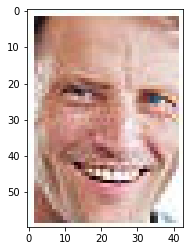

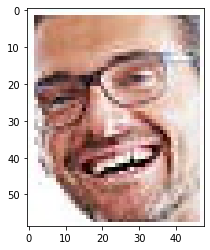

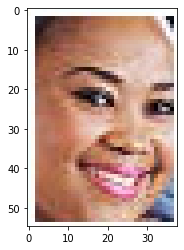

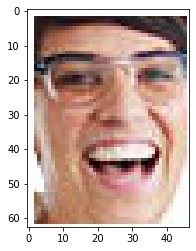

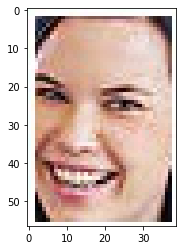

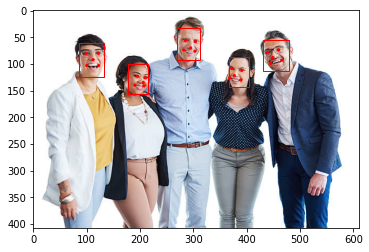

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [2]
Face  4 emotion [2]
[2, 2, 2, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 181ms/step
actual 4 predicted: 4


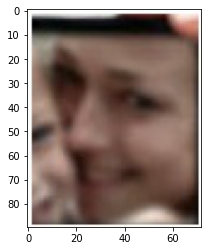

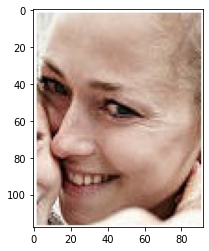

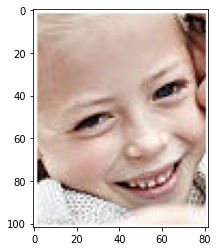

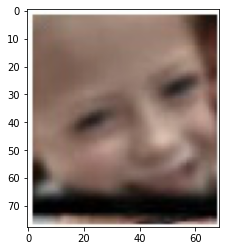

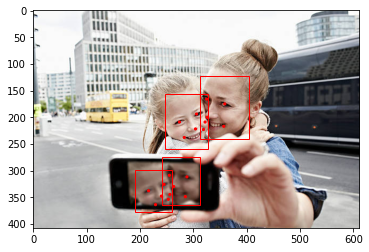

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [2]
[2, 2, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 178ms/step
actual 4 predicted: 4


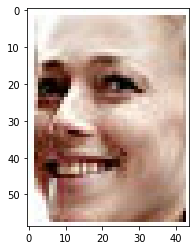

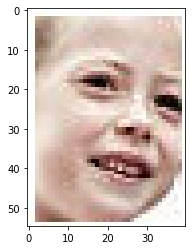

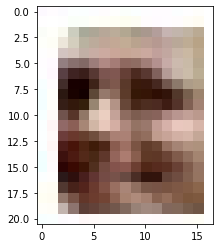

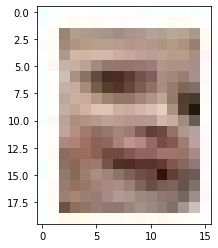

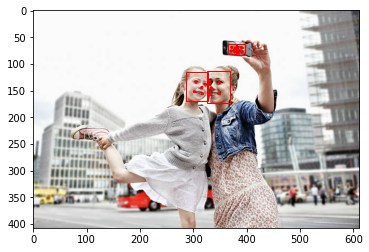

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [3]
Face  3 emotion [2]
[2, 2, 3, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 211ms/step
actual 4 predicted: 3


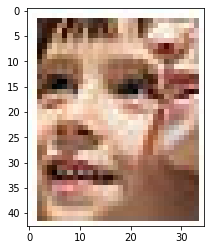

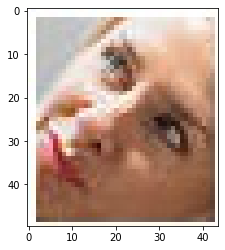

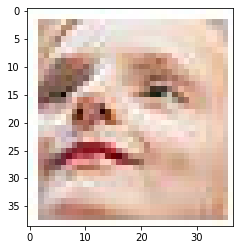

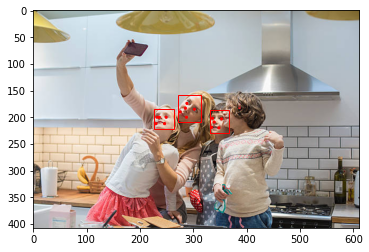

Face  0 emotion [0]
Face  1 emotion [1]
Face  2 emotion [3]
[0, 1, 3]
Dominant emotion:  0
1/1 [==============================] - 0s 172ms/step
actual 2 predicted: 2


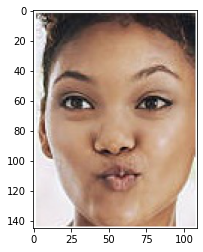

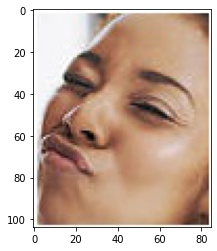

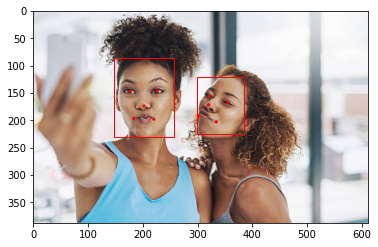

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
2/2 [==============================] - 0s 6ms/step
actual 8 predicted: 5


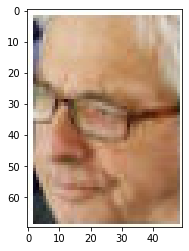

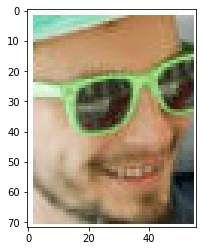

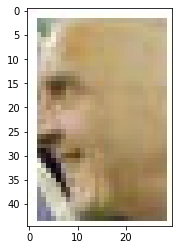

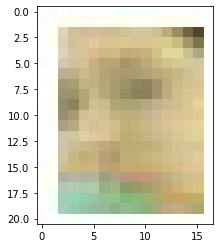

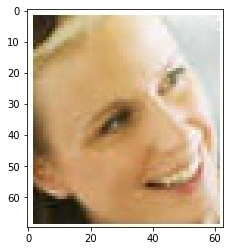

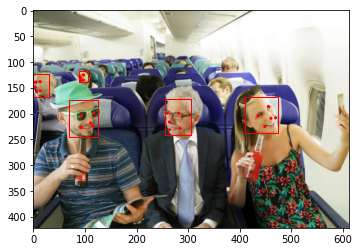

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [3]
Face  3 emotion [2]
Face  4 emotion [2]
[2, 2, 3, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 178ms/step
actual 3 predicted: 2


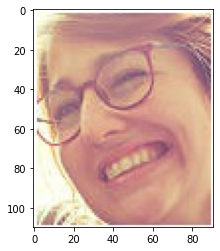

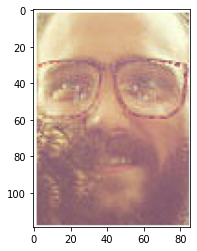

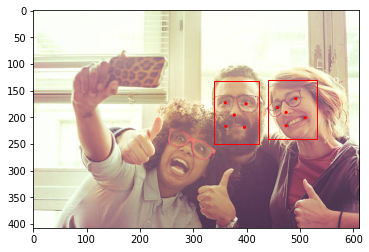

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 187ms/step
actual 4 predicted: 4


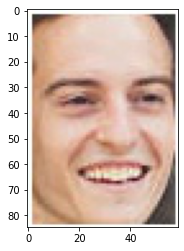

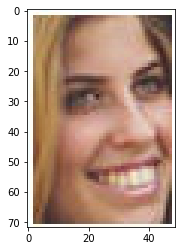

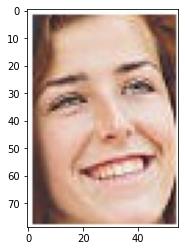

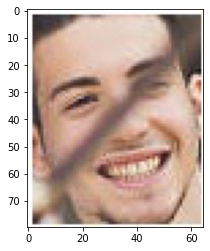

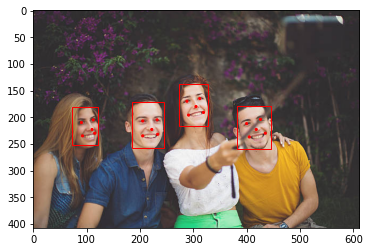

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [2]
[2, 2, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 207ms/step
actual 4 predicted: 4


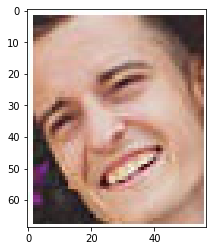

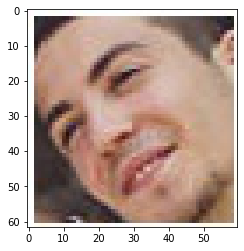

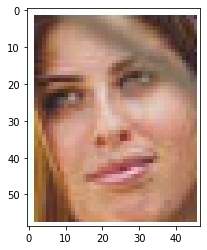

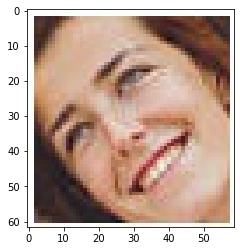

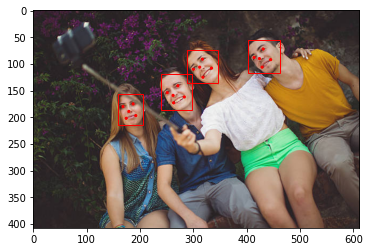

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [1]
Face  3 emotion [2]
[2, 2, 1, 2]
Dominant emotion:  2
3/3 [==============================] - 0s 7ms/step
actual 11 predicted: 11


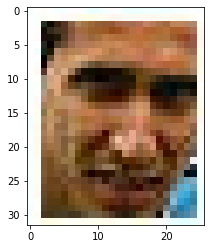

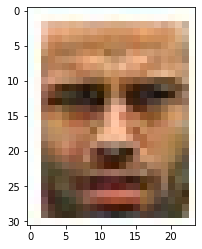

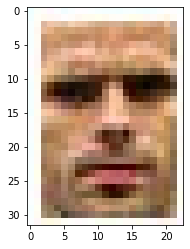

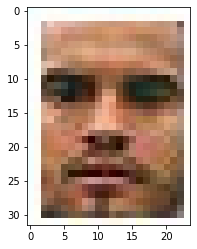

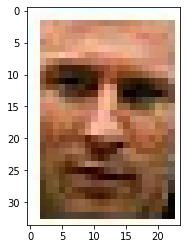

...

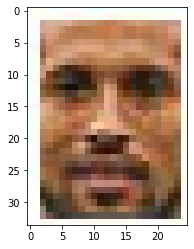

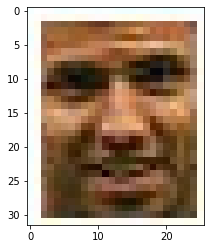

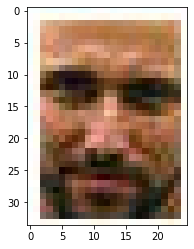

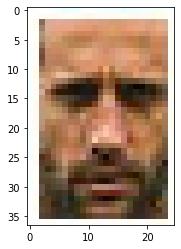

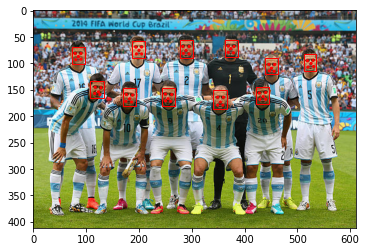

Face  0 emotion [2]
Face  1 emotion [0]
Face  2 emotion [2]
Face  3 emotion [2]
Face  4 emotion [2]
Face  5 emotion [2]
Face  6 emotion [0]
Face  7 emotion [2]
Face  8 emotion [2]
Face  9 emotion [2]
Face  10 emotion [0]
[2, 0, 2, 2, 2, 2, 0, 2, 2, 2, 0]
Dominant emotion:  2
1/1 [==============================] - 0s 183ms/step
actual 3 predicted: 3


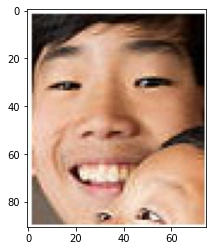

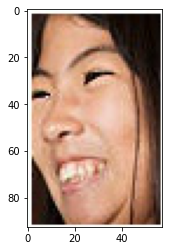

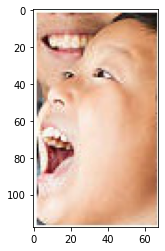

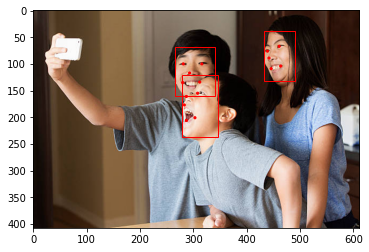

Face  0 emotion [0]
Face  1 emotion [2]
Face  2 emotion [2]
[0, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 180ms/step
actual 2 predicted: 2


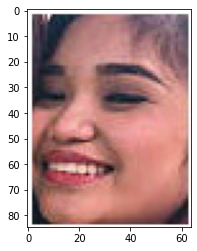

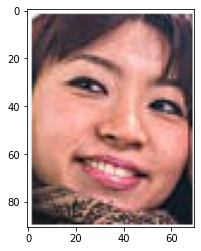

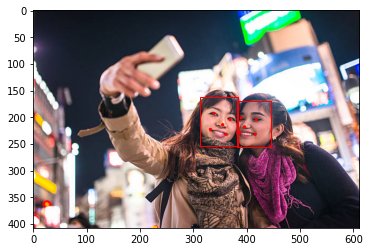

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
2/2 [==============================] - 0s 10ms/step
actual 2 predicted: 2


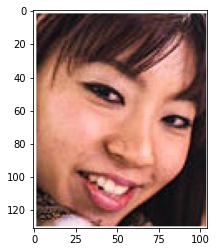

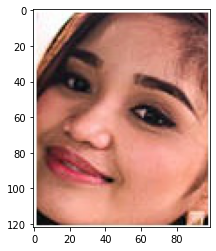

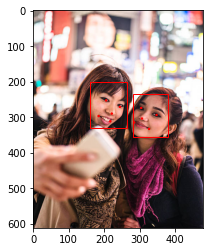

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
2/2 [==============================] - 0s 7ms/step
actual 2 predicted: 3


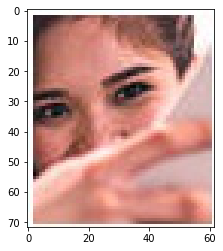

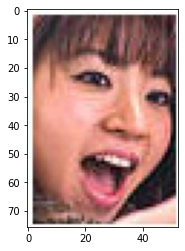

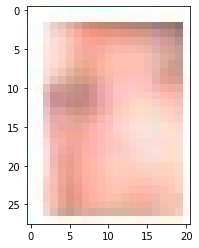

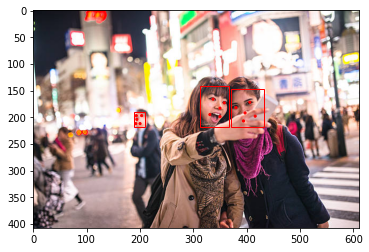

Face  0 emotion [0]
Face  1 emotion [2]
Face  2 emotion [2]
[0, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 184ms/step
actual 2 predicted: 2


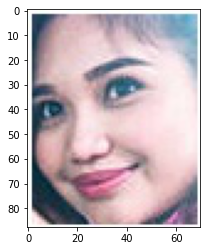

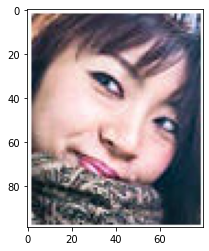

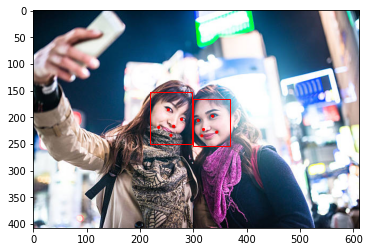

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 181ms/step
actual 2 predicted: 1


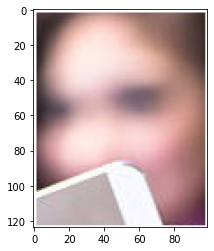

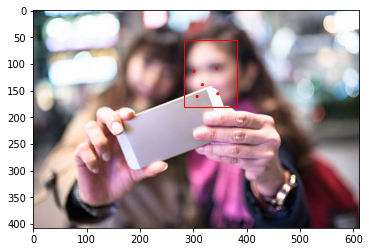

Face  0 emotion [2]
[2]
Dominant emotion:  2
1/1 [==============================] - 0s 192ms/step
actual 2 predicted: 3


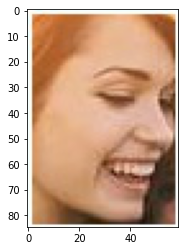

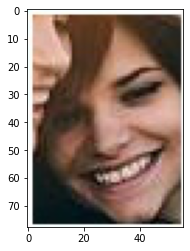

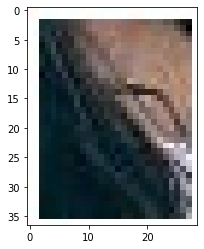

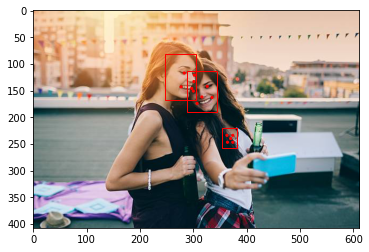

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
[2, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 145ms/step
actual 1 predicted: 0


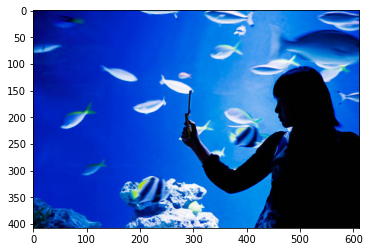

[]
No dominant emotion
1/1 [==============================] - 0s 180ms/step
actual 2 predicted: 1


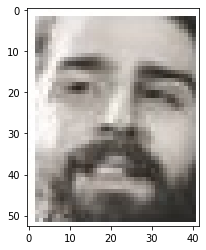

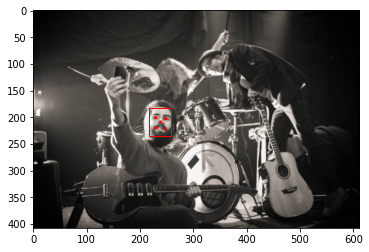

Face  0 emotion [0]
[0]
Dominant emotion:  0
1/1 [==============================] - 0s 187ms/step
actual 3 predicted: 2


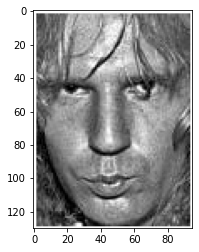

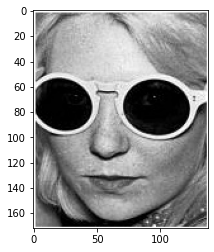

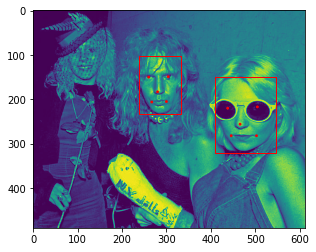

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
2/2 [==============================] - 0s 10ms/step
actual 6 predicted: 5


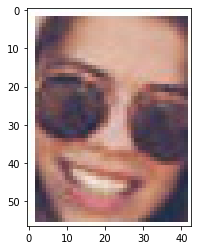

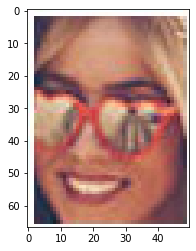

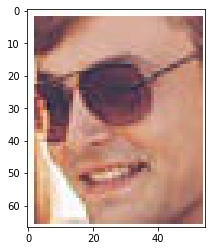

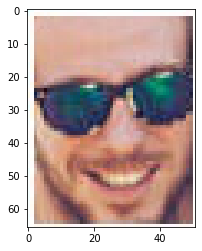

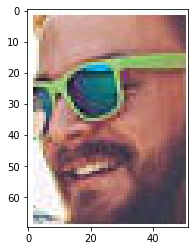

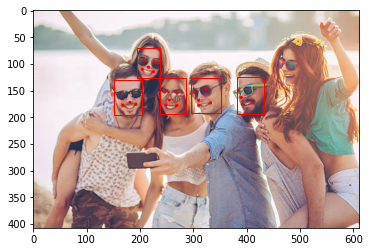

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [2]
Face  4 emotion [2]
[2, 2, 2, 2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 199ms/step
actual 3 predicted: 3


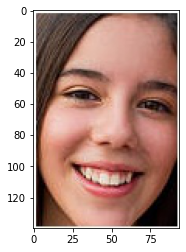

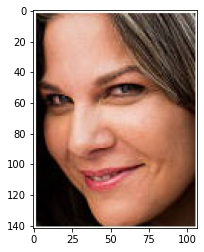

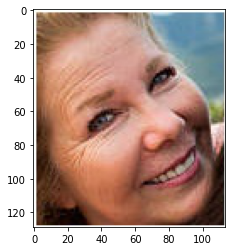

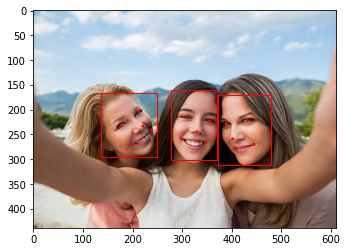

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [0]
[2, 2, 0]
Dominant emotion:  2
1/1 [==============================] - 0s 173ms/step
actual 2 predicted: 2


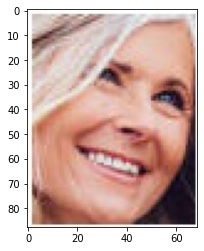

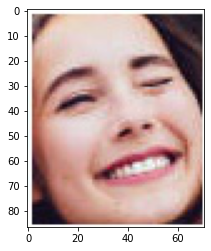

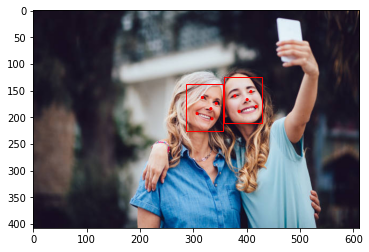

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
1/1 [==============================] - 0s 181ms/step
actual 2 predicted: 2


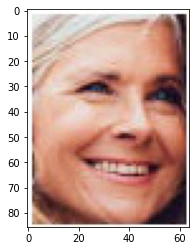

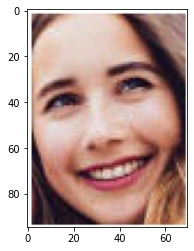

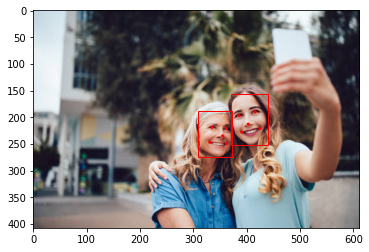

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2


In [ ]:
import statistics as st

imagesPath = 'train/image_data/'
size = 50
batch = []

for i in range(size):
  imagePath = imagesPath + data['Name'][i]
  # load image from file
  predicted_count, error, images = detect_faces(imagePath, data['HeadCount'][i])

  batch.append([])
  predictions = []
  for j in range(len(images)):
    pic = cv2.imread(images[j])
    pic = cv2.resize(pic, (224, 224))
    pic = pic.reshape(1,224,224,3)
    batch[-1].append(tensorflow.convert_to_tensor(pic))
  
    label = loaded_model.predict_on_batch(batch[i][j])
    label = tensorflow.nn.softmax(label)
    label = np.argmax(label, axis=1)
    print("Face ", j, "emotion", label)
    predictions.append(label[0])

  print(predictions)
  if (len(predictions) != 0):
    print("Dominant emotion: ", st.mode(predictions))
  else:
    print("No dominant emotion")
  


In [6]:
!unzip test_images_raw.zip

Archive:  test_images_raw.zip
   creating: test_images_raw/Angry/
  inflating: test_images_raw/Angry/0.jpg  
  inflating: test_images_raw/Angry/1.jpg  
  inflating: test_images_raw/Angry/10.jpg  
  inflating: test_images_raw/Angry/100.jpg  
  inflating: test_images_raw/Angry/101.jpg  
  inflating: test_images_raw/Angry/107.jpg  
  inflating: test_images_raw/Angry/11.jpg  
  inflating: test_images_raw/Angry/12.jpg  
  inflating: test_images_raw/Angry/13.jpg  
  inflating: test_images_raw/Angry/14.jpg  
  inflating: test_images_raw/Angry/15.jpg  
  inflating: test_images_raw/Angry/16.jpg  
  inflating: test_images_raw/Angry/18.jpg  
  inflating: test_images_raw/Angry/19.jpg  
  inflating: test_images_raw/Angry/2.jpg  
  inflating: test_images_raw/Angry/20.jpg  
  inflating: test_images_raw/Angry/25.jpg  
  inflating: test_images_raw/Angry/27.jpg  
  inflating: test_images_raw/Angry/29.jpg  
  inflating: test_images_raw/Angry/3.jpg  
  inflating: test_images_raw/Angry/31.jpg  
  inflating

In [9]:
import statistics as st
import os
import numpy as np 

def emotion_detector(folderPath, dir_list, emotion):
  batch = []
  matches = 0
  size = len(dir_list)
  print(size, dir_list)

  for i in range(size):
    imagePath = folderPath + '/' + dir_list[i]
    # load image from file
    predicted_count, error, images = detect_faces(imagePath, emotion)

    batch.append([])
    predictions = []
    for j in range(len(images)):
      pic = cv2.imread(images[j])
      pic = cv2.resize(pic, (224, 224))
      pic = pic.reshape(1,224,224,3)
      batch[-1].append(tensorflow.convert_to_tensor(pic))
    
      label = loaded_model.predict_on_batch(batch[i][j])
      label = tensorflow.nn.softmax(label)
      label = np.argmax(label, axis=1)
      print("Face ", j, "emotion", label)
      predictions.append(label[0])

    print(predictions)
    if (len(predictions) != 0):
      classification = st.mode(predictions)
      print("Dominant emotion: ", classification)
      if classification == emotion:
        matches += 1
    else:
      print("No dominant emotion")

    print(matches)
  return matches

Angry
42 ['44.jpg', '11.jpg', '31.jpg', '14.jpg', '19.jpg', '4.jpg', '18.jpg', '48.jpg', '34.jpg', '13.jpg', '61.jpg', '94.jpg', '2.jpg', '3.jpg', '107.jpg', '97.jpg', '53.jpg', '6.jpg', '63.jpg', '12.jpg', '7.jpg', '35.jpg', '100.jpg', '55.jpg', '65.jpg', '25.jpg', '1.jpg', '91.jpg', '101.jpg', '64.jpg', '16.jpg', '0.jpg', '9.jpg', '8.jpg', '27.jpg', '62.jpg', '10.jpg', '32.jpg', '5.jpg', '15.jpg', '29.jpg', '20.jpg']
1/1 [==============================] - 0s 105ms/step


1/1 [==============================] - 0s 109ms/step
actual 0 predicted: 1


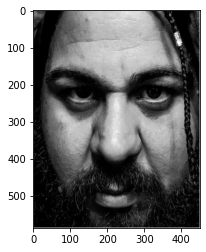

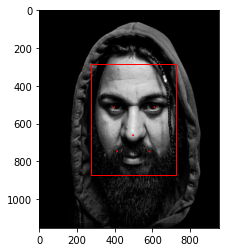

Face  0 emotion [3]
[3]
Dominant emotion:  3
0


1/1 [==============================] - 0s 149ms/step
actual 0 predicted: 1


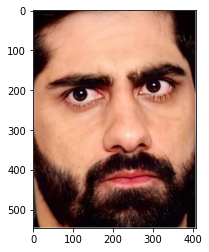

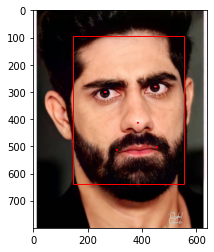

Face  0 emotion [3]
[3]
Dominant emotion:  3
0
1/1 [==============================] - 0s 150ms/step
actual 0 predicted: 2


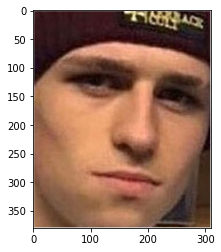

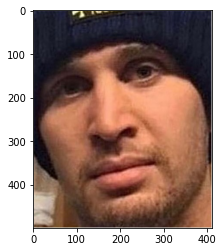

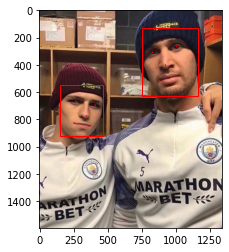

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
0
1/1 [==============================] - 0s 175ms/step
actual 0 predicted: 1


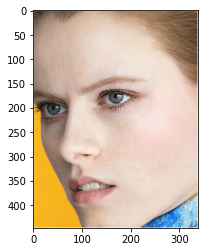

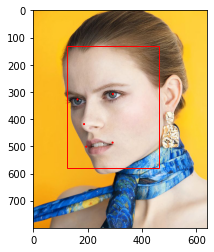

Face  0 emotion [2]
[2]
Dominant emotion:  2
0
1/1 [==============================] - 0s 109ms/step
actual 0 predicted: 0


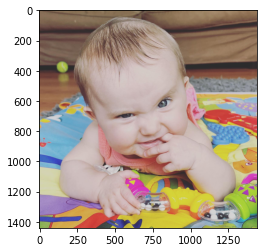

[]
No dominant emotion
0
1/1 [==============================] - 0s 128ms/step
actual 0 predicted: 1


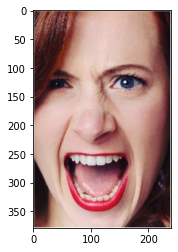

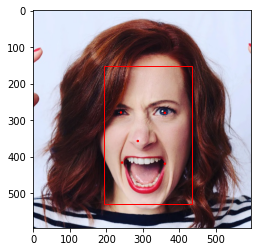

Face  0 emotion [0]
[0]
Dominant emotion:  0
1
1/1 [==============================] - 0s 117ms/step
actual 0 predicted: 1


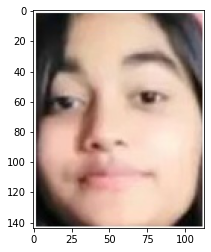

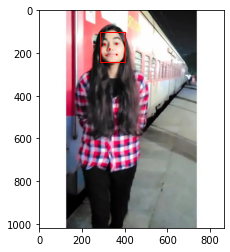

Face  0 emotion [0]
[0]
Dominant emotion:  0
2
1/1 [==============================] - 0s 159ms/step
actual 0 predicted: 0


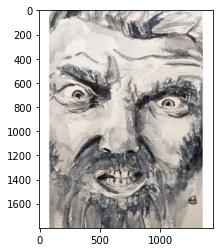

[]
No dominant emotion
2
1/1 [==============================] - 0s 148ms/step
actual 0 predicted: 1


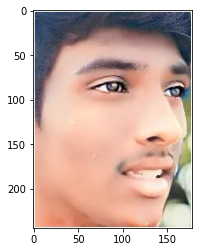

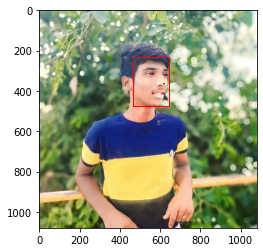

Face  0 emotion [0]
[0]
Dominant emotion:  0
3
1/1 [==============================] - 0s 102ms/step
actual 0 predicted: 1


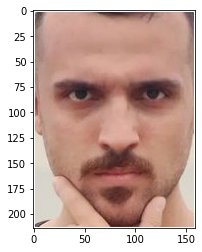

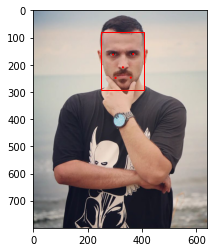

Face  0 emotion [0]
[0]
Dominant emotion:  0
4
2/2 [==============================] - 0s 48ms/step
actual 0 predicted: 2


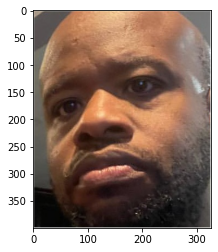

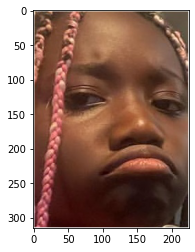

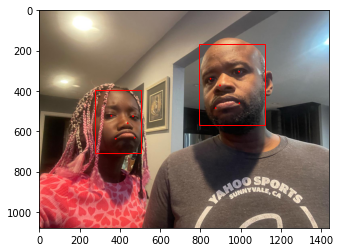

Face  0 emotion [2]
Face  1 emotion [3]
[2, 3]
Dominant emotion:  2
4
1/1 [==============================] - 0s 144ms/step
actual 0 predicted: 1


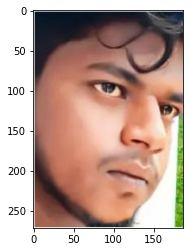

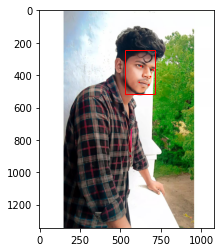

Face  0 emotion [2]
[2]
Dominant emotion:  2
4
1/1 [==============================] - 0s 106ms/step
actual 0 predicted: 1


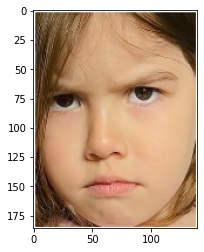

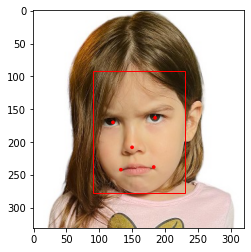

Face  0 emotion [2]
[2]
Dominant emotion:  2
4
1/1 [==============================] - 0s 101ms/step
actual 0 predicted: 1


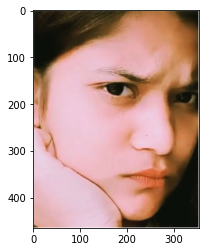

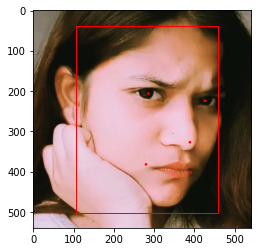

Face  0 emotion [2]
[2]
Dominant emotion:  2
4
4/4 [==============================] - 0s 19ms/step
actual 0 predicted: 14


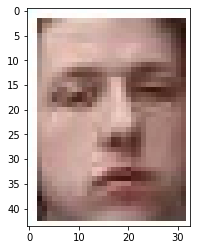

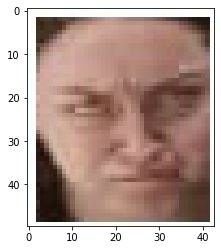

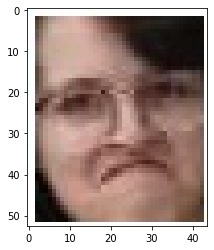

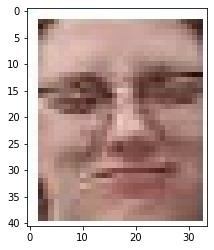

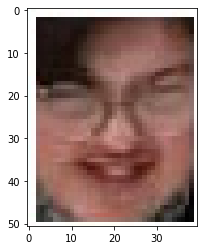

...

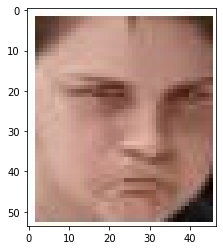

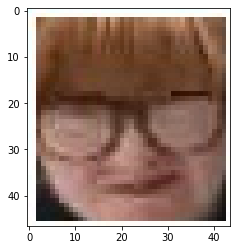

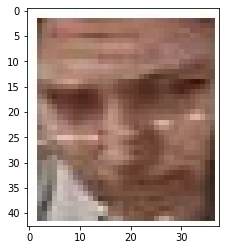

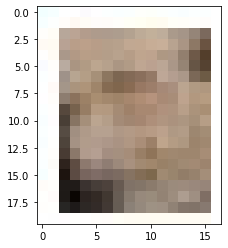

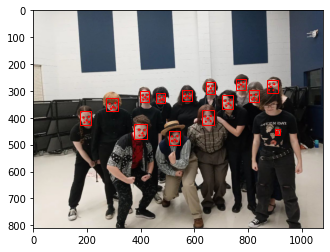

Face  0 emotion [0]
Face  1 emotion [3]
Face  2 emotion [2]
Face  3 emotion [2]
Face  4 emotion [2]
Face  5 emotion [2]
Face  6 emotion [2]
Face  7 emotion [2]
Face  8 emotion [2]
Face  9 emotion [0]
Face  10 emotion [2]
Face  11 emotion [2]
Face  12 emotion [2]
Face  13 emotion [2]
[0, 3, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2]
Dominant emotion:  2
4
1/1 [==============================] - 0s 138ms/step
actual 0 predicted: 1


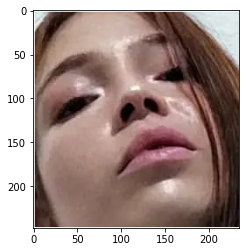

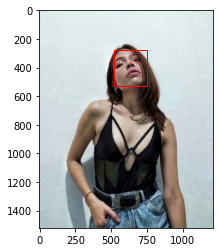

Face  0 emotion [2]
[2]
Dominant emotion:  2
4
2/2 [==============================] - 0s 16ms/step
actual 0 predicted: 1


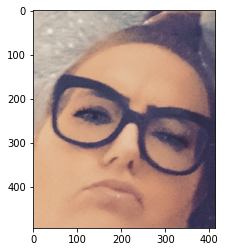

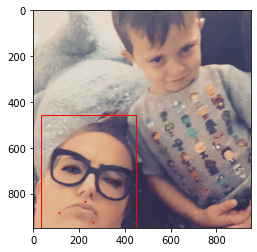

Face  0 emotion [2]
[2]
Dominant emotion:  2
4
1/1 [==============================] - 0s 162ms/step
actual 0 predicted: 1


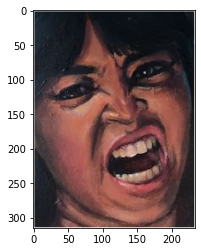

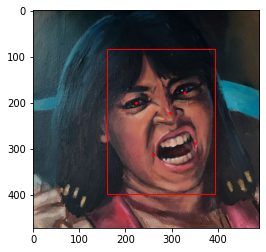

Face  0 emotion [2]
[2]
Dominant emotion:  2
4
1/1 [==============================] - 0s 181ms/step
actual 0 predicted: 1


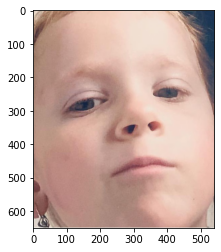

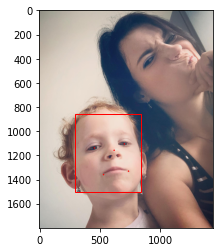

Face  0 emotion [0]
[0]
Dominant emotion:  0
5
1/1 [==============================] - 0s 112ms/step
actual 0 predicted: 1


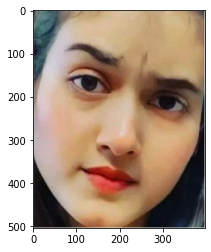

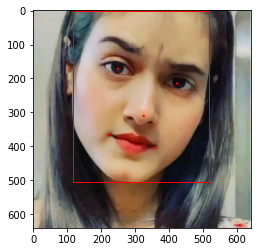

Face  0 emotion [2]
[2]
Dominant emotion:  2
5
1/1 [==============================] - 0s 113ms/step
actual 0 predicted: 1


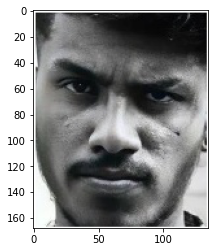

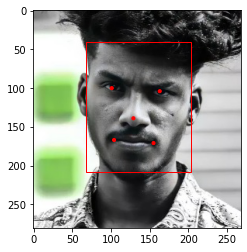

Face  0 emotion [0]
[0]
Dominant emotion:  0
6
1/1 [==============================] - 0s 183ms/step
actual 0 predicted: 2


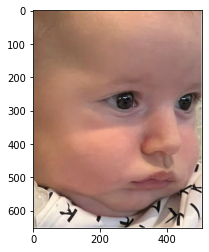

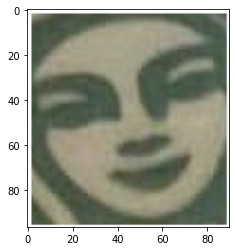

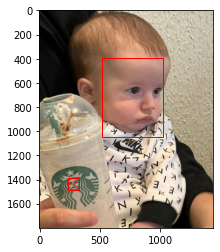

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
6
1/1 [==============================] - 0s 106ms/step
actual 0 predicted: 1


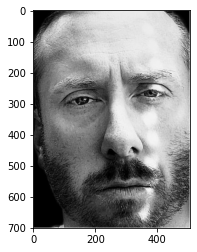

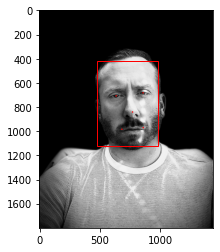

Face  0 emotion [0]
[0]
Dominant emotion:  0
7
1/1 [==============================] - 0s 180ms/step
actual 0 predicted: 1


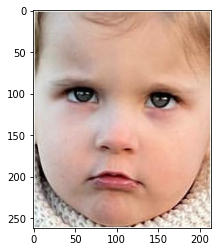

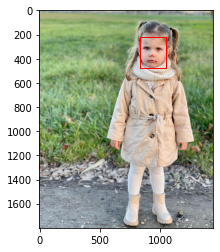

Face  0 emotion [3]
[3]
Dominant emotion:  3
7
4/4 [==============================] - 0s 22ms/step
actual 0 predicted: 0


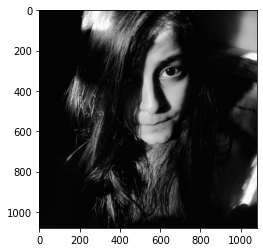

[]
No dominant emotion
7
1/1 [==============================] - 0s 197ms/step
actual 0 predicted: 1


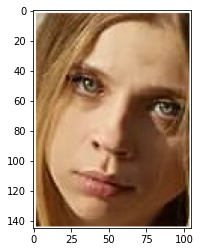

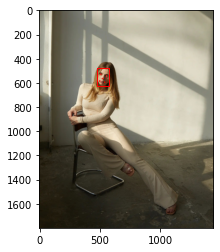

Face  0 emotion [1]
[1]
Dominant emotion:  1
7
1/1 [==============================] - 0s 117ms/step
actual 0 predicted: 1


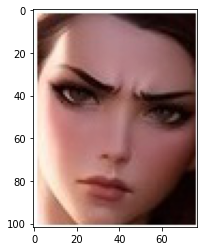

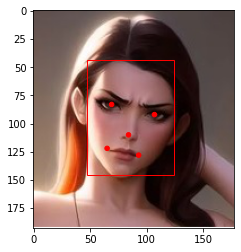

Face  0 emotion [0]
[0]
Dominant emotion:  0
8
1/1 [==============================] - 0s 102ms/step
actual 0 predicted: 1


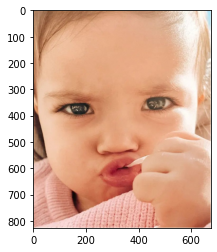

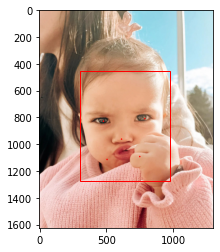

Face  0 emotion [2]
[2]
Dominant emotion:  2
8
1/1 [==============================] - 0s 111ms/step
actual 0 predicted: 1


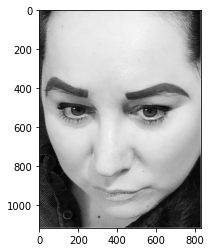

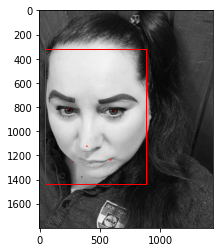

Face  0 emotion [2]
[2]
Dominant emotion:  2
8
1/1 [==============================] - 0s 110ms/step
actual 0 predicted: 3


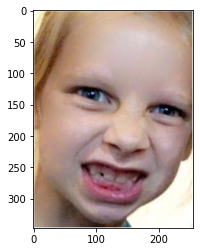

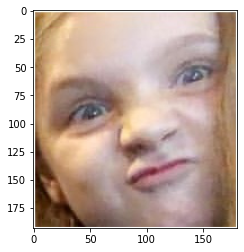

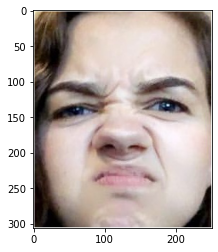

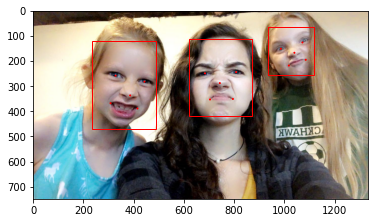

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [0]
[2, 2, 0]
Dominant emotion:  2
8
1/1 [==============================] - 0s 155ms/step
actual 0 predicted: 1


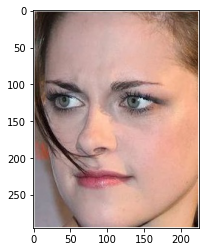

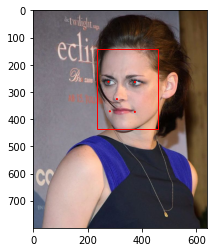

Face  0 emotion [2]
[2]
Dominant emotion:  2
8
1/1 [==============================] - 0s 160ms/step
actual 0 predicted: 1


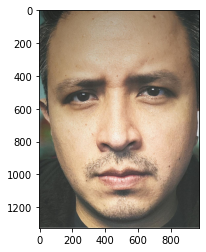

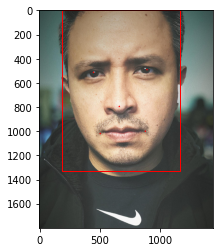

Face  0 emotion [0]
[0]
Dominant emotion:  0
9
1/1 [==============================] - 0s 164ms/step
actual 0 predicted: 1


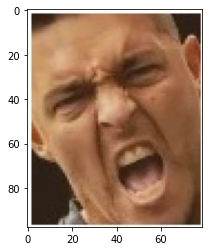

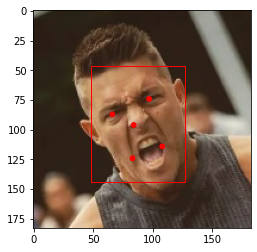

Face  0 emotion [0]
[0]
Dominant emotion:  0
10
1/1 [==============================] - 0s 229ms/step
actual 0 predicted: 1


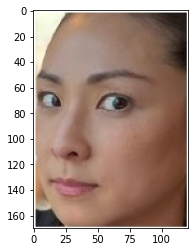

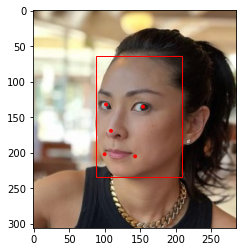

Face  0 emotion [0]
[0]
Dominant emotion:  0
11
1/1 [==============================] - 0s 178ms/step
actual 0 predicted: 1


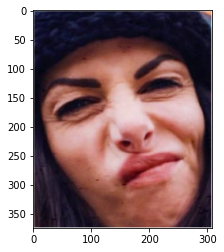

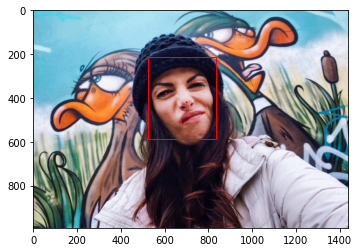

Face  0 emotion [2]
[2]
Dominant emotion:  2
11
1/1 [==============================] - 0s 163ms/step
actual 0 predicted: 2


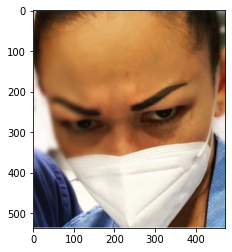

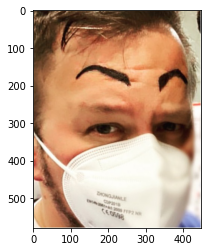

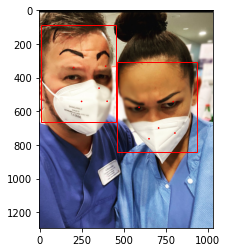

Face  0 emotion [3]
Face  1 emotion [0]
[3, 0]
Dominant emotion:  3
11
1/1 [==============================] - 0s 170ms/step
actual 0 predicted: 1


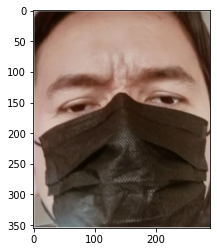

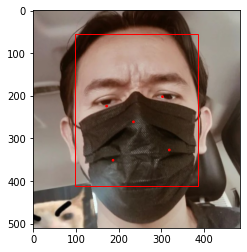

Face  0 emotion [2]
[2]
Dominant emotion:  2
11
1/1 [==============================] - 0s 207ms/step
actual 0 predicted: 1


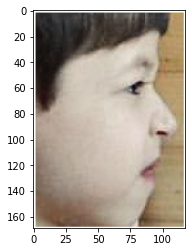

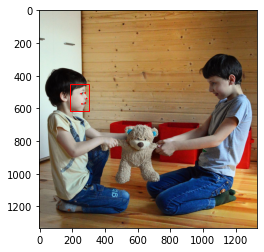

Face  0 emotion [3]
[3]
Dominant emotion:  3
11
1/1 [==============================] - 0s 146ms/step
actual 0 predicted: 1


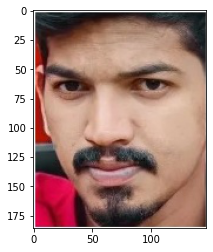

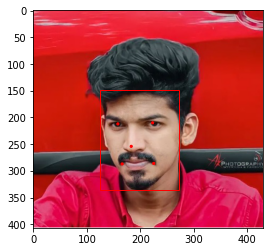

Face  0 emotion [0]
[0]
Dominant emotion:  0
12
1/1 [==============================] - 0s 156ms/step
actual 0 predicted: 1


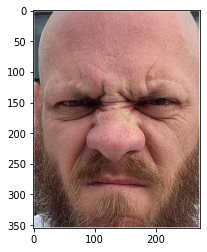

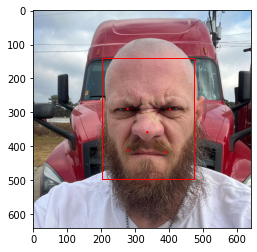

Face  0 emotion [2]
[2]
Dominant emotion:  2
12
1/1 [==============================] - 0s 201ms/step
actual 0 predicted: 1


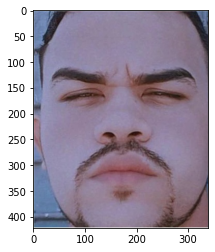

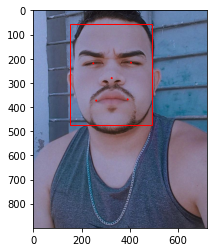

Face  0 emotion [3]
[3]
Dominant emotion:  3
12
1/1 [==============================] - 0s 170ms/step
actual 0 predicted: 1


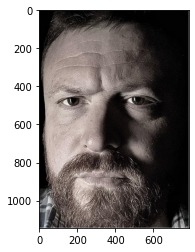

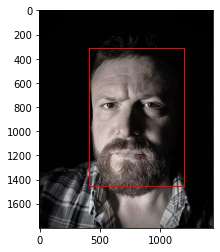

Face  0 emotion [2]
[2]
Dominant emotion:  2
12
Fear
51 ['42.jpg', '44.jpg', '33.jpg', '11.jpg', '31.jpg', '51.jpg', '14.jpg', '30.jpg', '17.jpg', '4.jpg', '98.jpg', '13.jpg', '144.jpg', '2.jpg', '3.jpg', '77.jpg', '113.jpg', '53.jpg', '6.jpg', '63.jpg', '119.jpg', '72.jpg', '23.jpg', '137.jpg', '12.jpg', '7.jpg', '52.jpg', '100.jpg', '21.jpg', '84.jpg', '59.jpg', '93.jpg', '124.jpg', '1.jpg', '68.jpg', '70.jpg', '64.jpg', '16.jpg', '0.jpg', '9.jpg', '56.jpg', '47.jpg', '8.jpg', '10.jpg', '126.jpg', '102.jpg', '5.jpg', '22.jpg', '24.jpg', '15.jpg', '29.jpg']
1/1 [==============================] - 0s 153ms/step
actual 1 predicted: 0


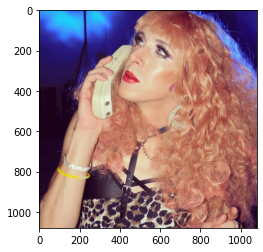

[]
No dominant emotion
0
1/1 [==============================] - 0s 250ms/step
actual 1 predicted: 2


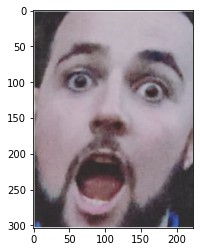

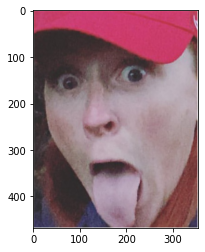

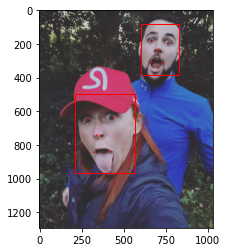

Face  0 emotion [1]
Face  1 emotion [3]
[1, 3]
Dominant emotion:  1
1
1/1 [==============================] - 0s 159ms/step
actual 1 predicted: 2


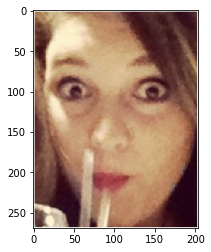

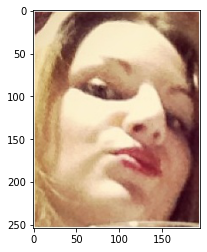

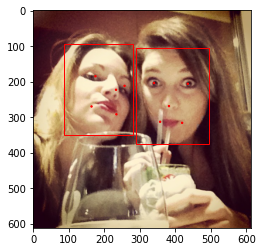

Face  0 emotion [1]
Face  1 emotion [0]
[1, 0]
Dominant emotion:  1
2
1/1 [==============================] - 0s 201ms/step
actual 1 predicted: 1


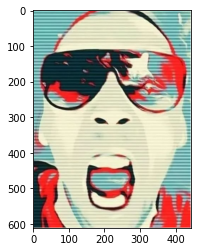

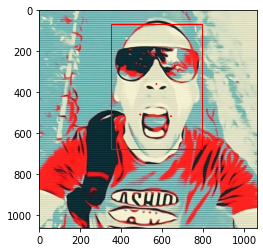

Face  0 emotion [2]
[2]
Dominant emotion:  2
2
1/1 [==============================] - 0s 153ms/step
actual 1 predicted: 2


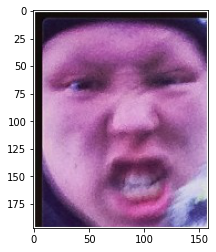

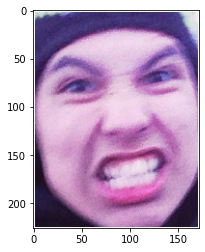

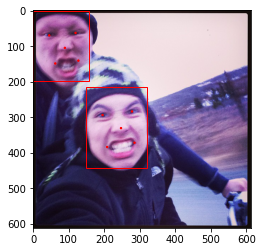

Face  0 emotion [0]
Face  1 emotion [2]
[0, 2]
Dominant emotion:  0
2
3/3 [==============================] - 0s 27ms/step
actual 1 predicted: 3


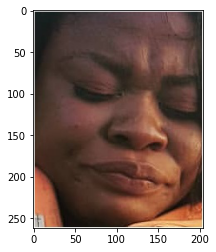

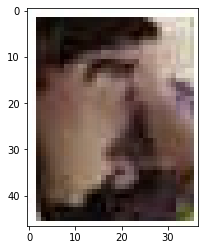

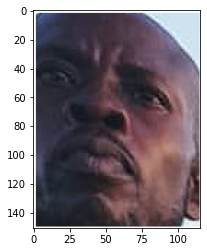

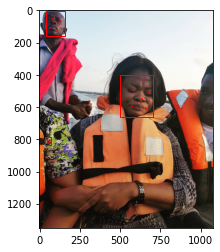

Face  0 emotion [2]
Face  1 emotion [1]
Face  2 emotion [3]
[2, 1, 3]
Dominant emotion:  2
2
1/1 [==============================] - 0s 200ms/step
actual 1 predicted: 1


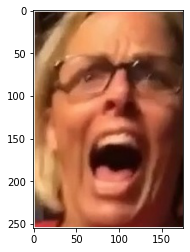

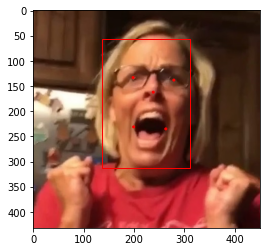

Face  0 emotion [0]
[0]
Dominant emotion:  0
2
1/1 [==============================] - 0s 158ms/step
actual 1 predicted: 1


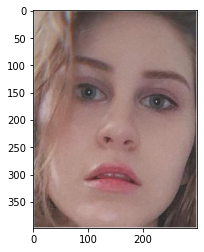

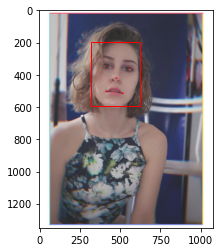

Face  0 emotion [2]
[2]
Dominant emotion:  2
2
1/1 [==============================] - 0s 148ms/step
actual 1 predicted: 0


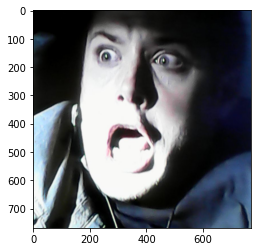

[]
No dominant emotion
2
1/1 [==============================] - 0s 155ms/step
actual 1 predicted: 1


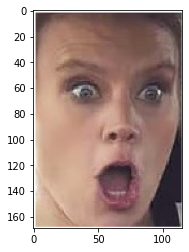

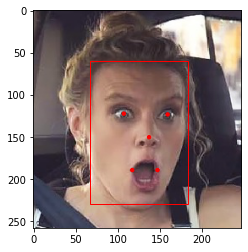

Face  0 emotion [0]
[0]
Dominant emotion:  0
2
1/1 [==============================] - 0s 160ms/step
actual 1 predicted: 1


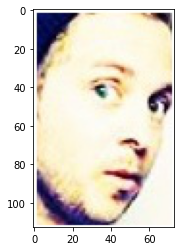

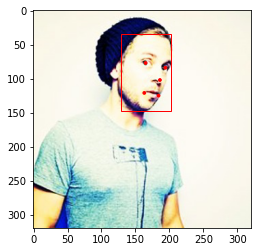

Face  0 emotion [2]
[2]
Dominant emotion:  2
2
1/1 [==============================] - 0s 173ms/step
actual 1 predicted: 1


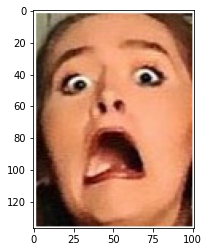

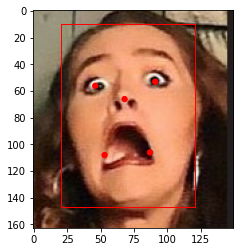

Face  0 emotion [1]
[1]
Dominant emotion:  1
3
1/1 [==============================] - 0s 249ms/step
actual 1 predicted: 1


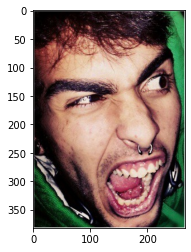

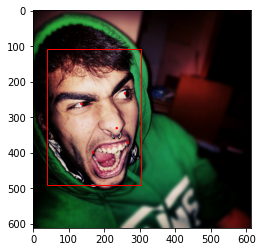

Face  0 emotion [2]
[2]
Dominant emotion:  2
3
1/1 [==============================] - 0s 167ms/step
actual 1 predicted: 1


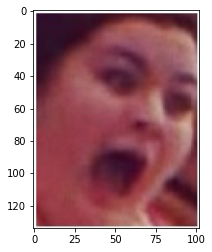

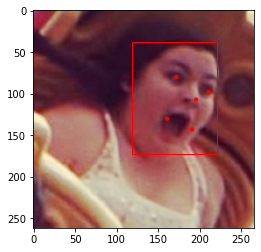

Face  0 emotion [2]
[2]
Dominant emotion:  2
3
1/1 [==============================] - 0s 162ms/step
actual 1 predicted: 1


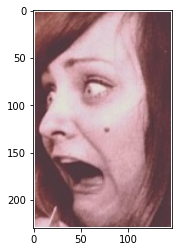

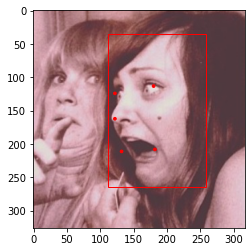

Face  0 emotion [0]
[0]
Dominant emotion:  0
3
1/1 [==============================] - 0s 154ms/step
actual 1 predicted: 1


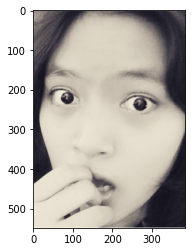

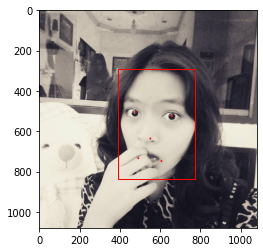

Face  0 emotion [1]
[1]
Dominant emotion:  1
4
1/1 [==============================] - 0s 168ms/step
actual 1 predicted: 1


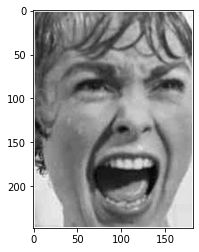

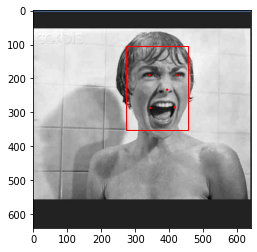

Face  0 emotion [0]
[0]
Dominant emotion:  0
4
1/1 [==============================] - 0s 225ms/step
actual 1 predicted: 2


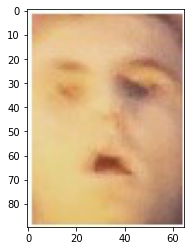

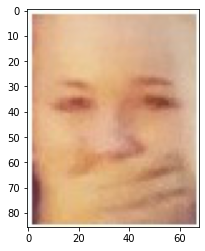

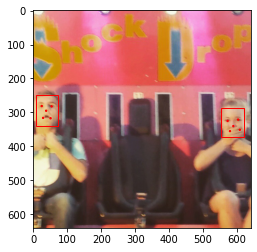

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
4
1/1 [==============================] - 0s 153ms/step
actual 1 predicted: 1


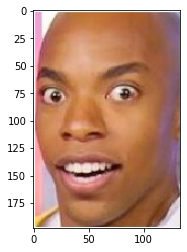

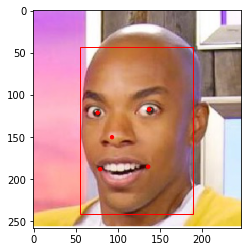

Face  0 emotion [2]
[2]
Dominant emotion:  2
4
1/1 [==============================] - 0s 154ms/step
actual 1 predicted: 2


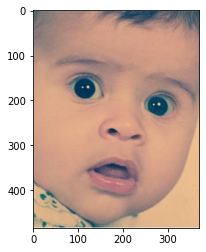

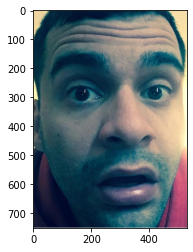

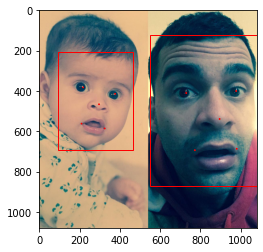

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
4
1/1 [==============================] - 0s 155ms/step
actual 1 predicted: 1


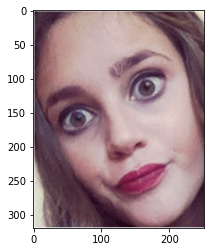

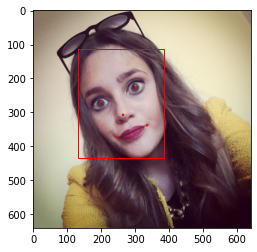

Face  0 emotion [2]
[2]
Dominant emotion:  2
4
1/1 [==============================] - 0s 164ms/step
actual 1 predicted: 2


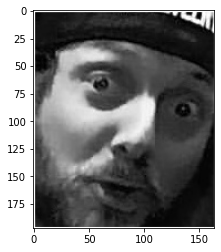

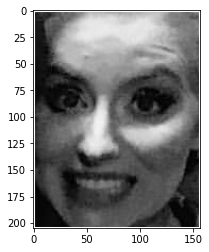

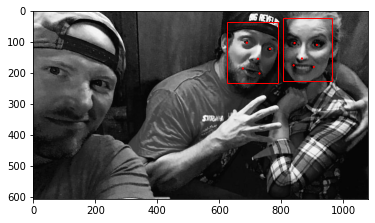

Face  0 emotion [1]
Face  1 emotion [0]
[1, 0]
Dominant emotion:  1
5
2/2 [==============================] - 0s 89ms/step
actual 1 predicted: 1


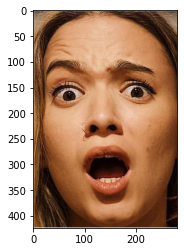

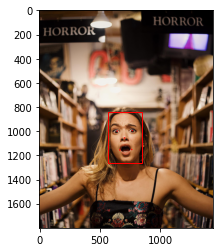

Face  0 emotion [0]
[0]
Dominant emotion:  0
5
1/1 [==============================] - 0s 162ms/step
actual 1 predicted: 1


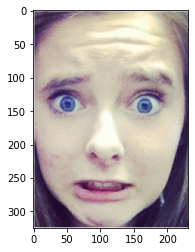

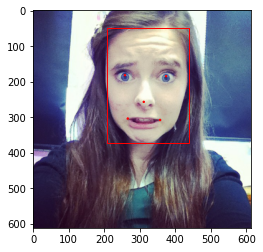

Face  0 emotion [1]
[1]
Dominant emotion:  1
6
1/1 [==============================] - 0s 166ms/step
actual 1 predicted: 1


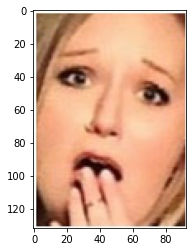

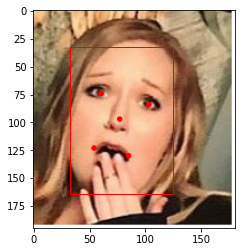

Face  0 emotion [1]
[1]
Dominant emotion:  1
7
1/1 [==============================] - 0s 159ms/step
actual 1 predicted: 1


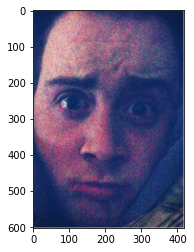

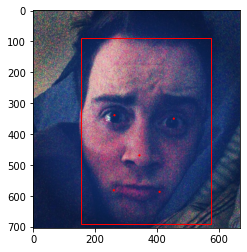

Face  0 emotion [3]
[3]
Dominant emotion:  3
7
1/1 [==============================] - 0s 149ms/step
actual 1 predicted: 4


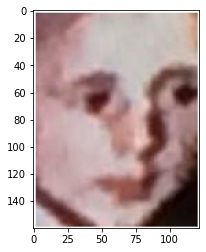

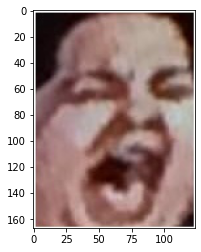

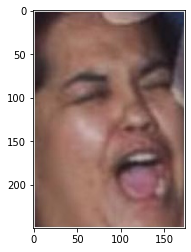

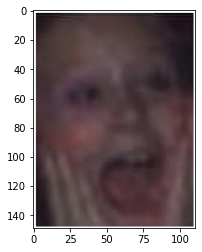

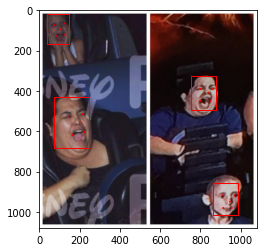

Face  0 emotion [0]
Face  1 emotion [0]
Face  2 emotion [0]
Face  3 emotion [0]
[0, 0, 0, 0]
Dominant emotion:  0
7
1/1 [==============================] - 0s 152ms/step
actual 1 predicted: 1


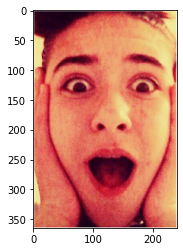

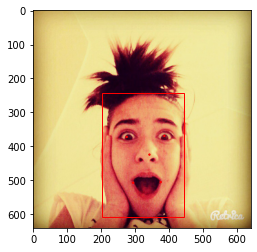

Face  0 emotion [1]
[1]
Dominant emotion:  1
8
1/1 [==============================] - 0s 175ms/step
actual 1 predicted: 1


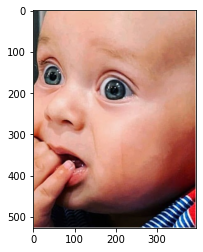

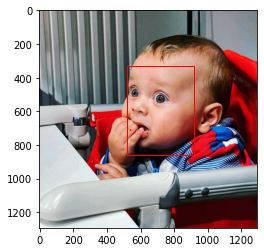

Face  0 emotion [2]
[2]
Dominant emotion:  2
8
1/1 [==============================] - 0s 160ms/step
actual 1 predicted: 1


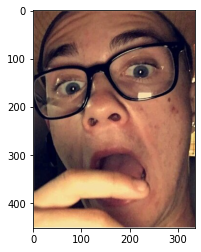

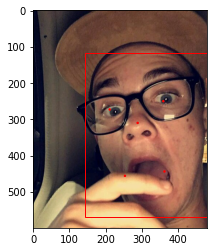

Face  0 emotion [2]
[2]
Dominant emotion:  2
8
2/2 [==============================] - 0s 8ms/step
actual 1 predicted: 3


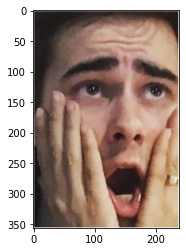

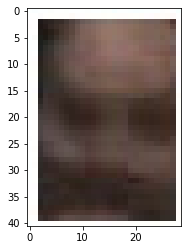

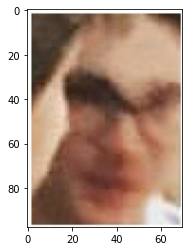

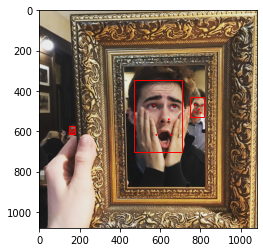

Face  0 emotion [1]
Face  1 emotion [2]
Face  2 emotion [0]
[1, 2, 0]
Dominant emotion:  1
9
1/1 [==============================] - 0s 174ms/step
actual 1 predicted: 2


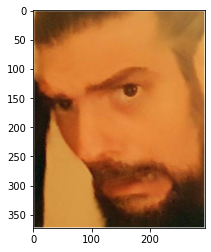

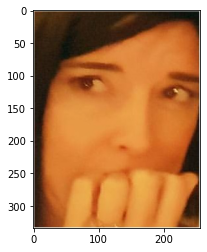

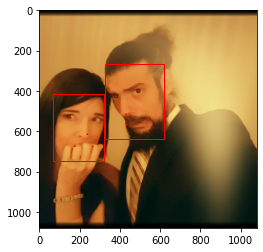

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
9
1/1 [==============================] - 0s 154ms/step
actual 1 predicted: 1


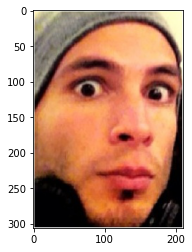

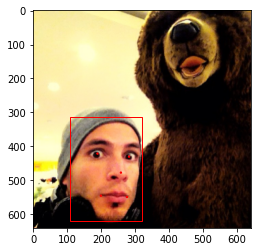

Face  0 emotion [3]
[3]
Dominant emotion:  3
9
1/1 [==============================] - 0s 153ms/step
actual 1 predicted: 1


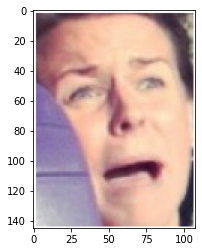

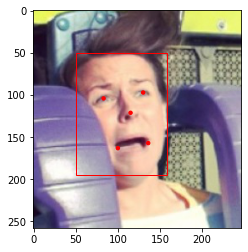

Face  0 emotion [2]
[2]
Dominant emotion:  2
9
1/1 [==============================] - 0s 158ms/step
actual 1 predicted: 0


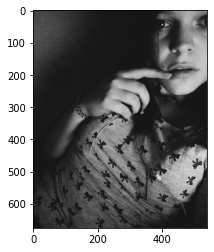

[]
No dominant emotion
9
1/1 [==============================] - 0s 150ms/step
actual 1 predicted: 1


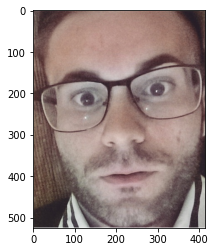

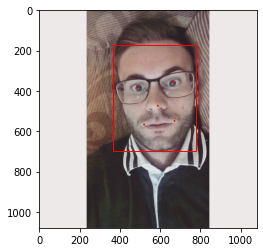

Face  0 emotion [3]
[3]
Dominant emotion:  3
9
1/1 [==============================] - 0s 165ms/step
actual 1 predicted: 1


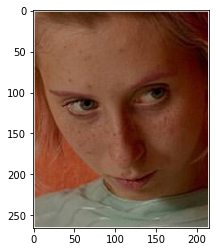

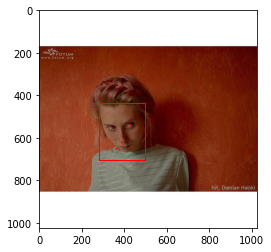

Face  0 emotion [2]
[2]
Dominant emotion:  2
9
1/1 [==============================] - 0s 200ms/step
actual 1 predicted: 2


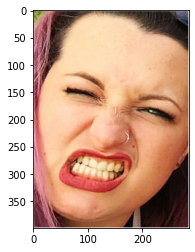

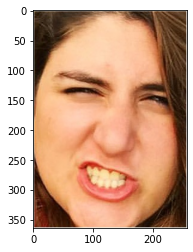

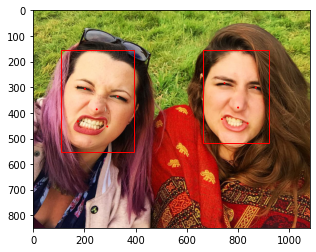

Face  0 emotion [0]
Face  1 emotion [2]
[0, 2]
Dominant emotion:  0
9
2/2 [==============================] - 0s 8ms/step
actual 1 predicted: 4


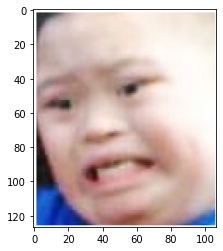

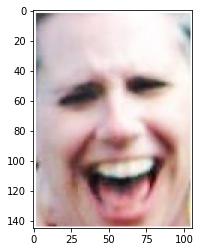

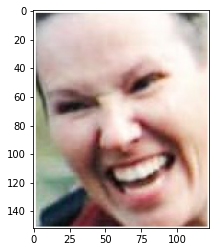

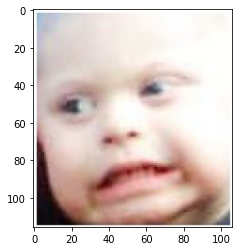

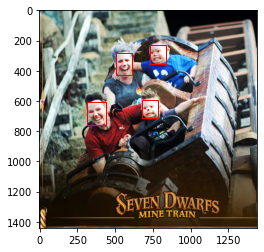

Face  0 emotion [0]
Face  1 emotion [2]
Face  2 emotion [2]
Face  3 emotion [2]
[0, 2, 2, 2]
Dominant emotion:  2
9
1/1 [==============================] - 0s 166ms/step
actual 1 predicted: 1


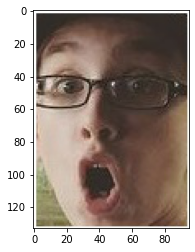

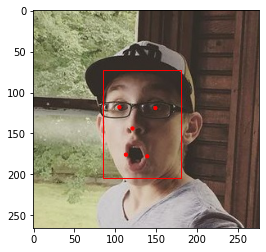

Face  0 emotion [0]
[0]
Dominant emotion:  0
9
1/1 [==============================] - 0s 152ms/step
actual 1 predicted: 1


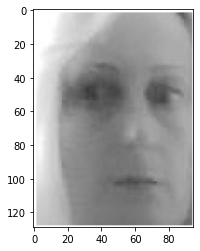

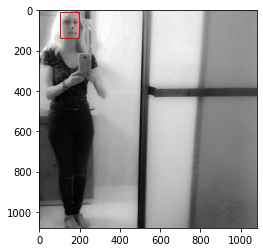

Face  0 emotion [1]
[1]
Dominant emotion:  1
10
1/1 [==============================] - 0s 155ms/step
actual 1 predicted: 1


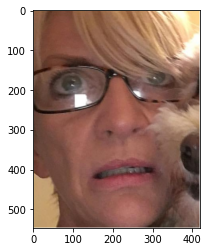

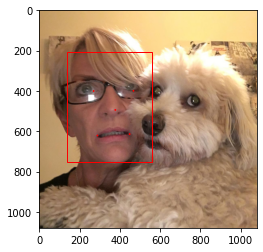

Face  0 emotion [2]
[2]
Dominant emotion:  2
10
1/1 [==============================] - 0s 168ms/step
actual 1 predicted: 1


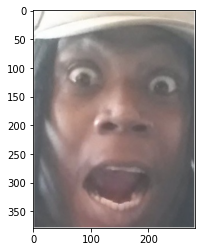

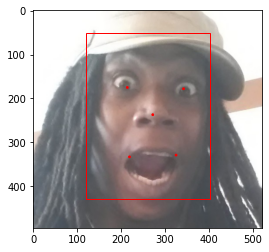

Face  0 emotion [2]
[2]
Dominant emotion:  2
10
1/1 [==============================] - 0s 173ms/step
actual 1 predicted: 1


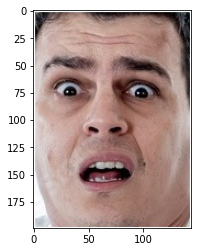

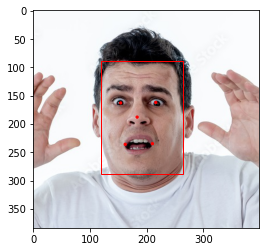

Face  0 emotion [1]
[1]
Dominant emotion:  1
11
1/1 [==============================] - 0s 155ms/step
actual 1 predicted: 1


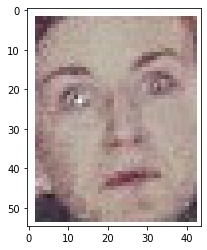

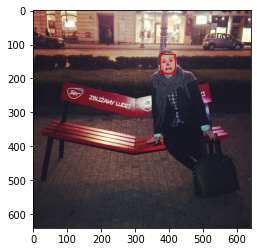

Face  0 emotion [1]
[1]
Dominant emotion:  1
12
1/1 [==============================] - 0s 156ms/step
actual 1 predicted: 4


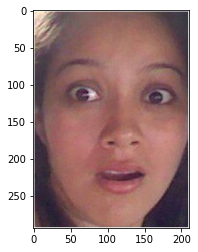

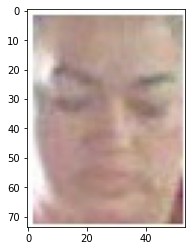

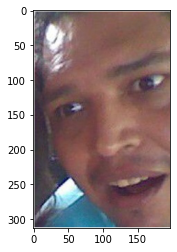

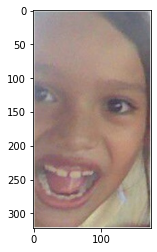

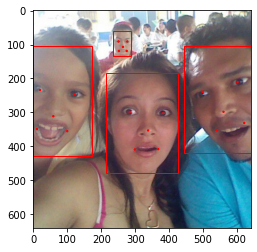

Face  0 emotion [2]
Face  1 emotion [3]
Face  2 emotion [2]
Face  3 emotion [2]
[2, 3, 2, 2]
Dominant emotion:  2
12
1/1 [==============================] - 0s 159ms/step
actual 1 predicted: 1


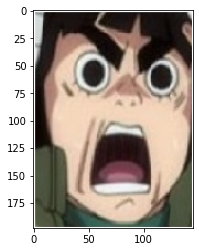

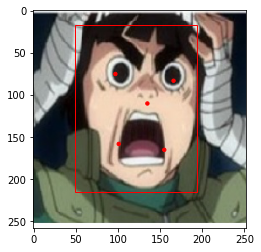

Face  0 emotion [0]
[0]
Dominant emotion:  0
12
1/1 [==============================] - 0s 239ms/step
actual 1 predicted: 2


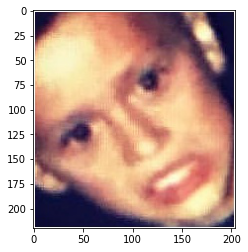

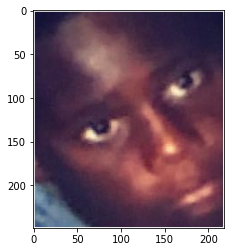

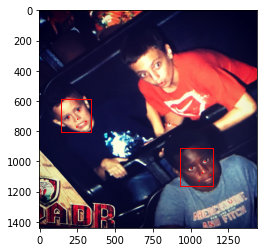

Face  0 emotion [3]
Face  1 emotion [3]
[3, 3]
Dominant emotion:  3
12
1/1 [==============================] - 0s 152ms/step
actual 1 predicted: 2


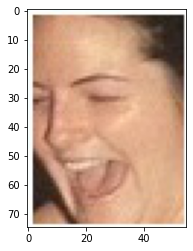

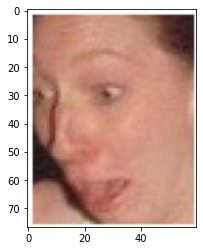

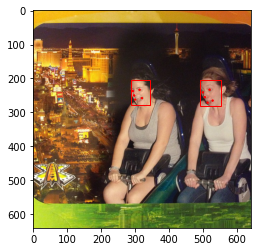

Face  0 emotion [2]
Face  1 emotion [3]
[2, 3]
Dominant emotion:  2
12
1/1 [==============================] - 0s 154ms/step
actual 1 predicted: 1


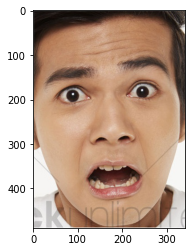

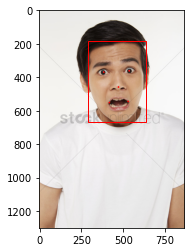

Face  0 emotion [2]
[2]
Dominant emotion:  2
12
1/1 [==============================] - 0s 236ms/step
actual 1 predicted: 1


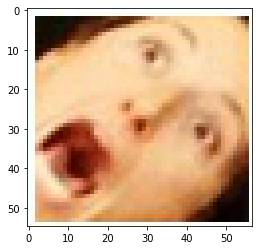

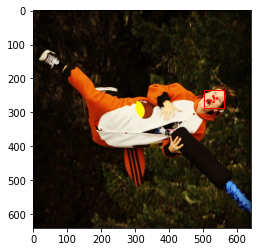

Face  0 emotion [3]
[3]
Dominant emotion:  3
12
Happy
104 ['42.jpg', '104.jpg', '142.jpg', '33.jpg', '111.jpg', '11.jpg', '31.jpg', '51.jpg', '14.jpg', '30.jpg', '123.jpg', '17.jpg', '19.jpg', '60.jpg', '4.jpg', '76.jpg', '71.jpg', '67.jpg', '105.jpg', '18.jpg', '48.jpg', '34.jpg', '54.jpg', '132.jpg', '98.jpg', '200.jpg', '106.jpg', '13.jpg', '49.jpg', '37.jpg', '156.jpg', '94.jpg', '118.jpg', '2.jpg', '90.jpg', '3.jpg', '97.jpg', '77.jpg', '114.jpg', '96.jpg', '113.jpg', '53.jpg', '6.jpg', '63.jpg', '129.jpg', '110.jpg', '72.jpg', '125.jpg', '23.jpg', '92.jpg', '50.jpg', '12.jpg', '7.jpg', '103.jpg', '39.jpg', '35.jpg', '52.jpg', '100.jpg', '21.jpg', '46.jpg', '58.jpg', '59.jpg', '55.jpg', '93.jpg', '65.jpg', '25.jpg', '1.jpg', '91.jpg', '95.jpg', '38.jpg', '43.jpg', '101.jpg', '70.jpg', '28.jpg', '64.jpg', '16.jpg', '66.jpg', '83.jpg', '57.jpg', '0.jpg', '9.jpg', '40.jpg', '56.jpg', '47.jpg', '8.jpg', '41.jpg', '27.jpg', '62.jpg', '10.jpg', '32.jpg', '81.jpg', '108.jpg', '26.jpg', '

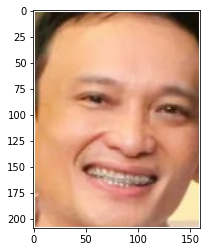

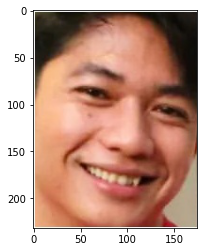

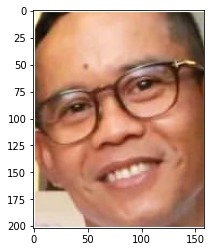

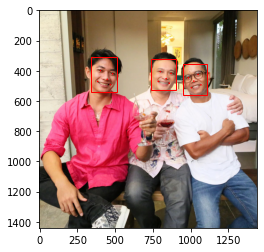

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
[2, 2, 2]
Dominant emotion:  2
1
2/2 [==============================] - 0s 6ms/step
actual 2 predicted: 2


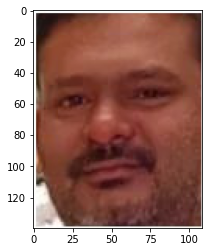

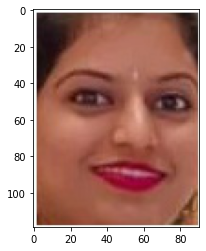

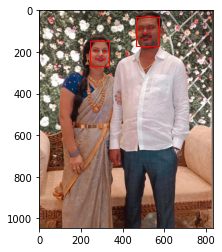

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
2
2/2 [==============================] - 0s 9ms/step
actual 2 predicted: 2


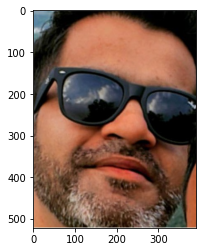

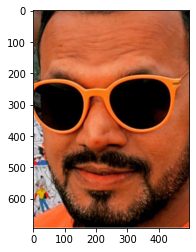

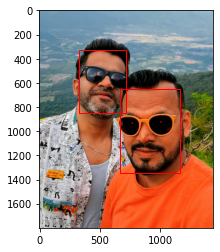

Face  0 emotion [2]
Face  1 emotion [2]
[2, 2]
Dominant emotion:  2
3
1/1 [==============================] - 0s 164ms/step
actual 2 predicted: 1


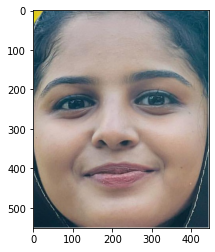

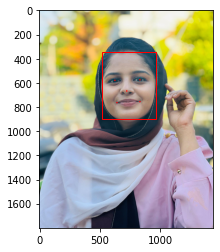

Face  0 emotion [2]
[2]
Dominant emotion:  2
4
1/1 [==============================] - 0s 164ms/step
actual 2 predicted: 2


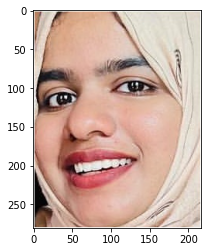

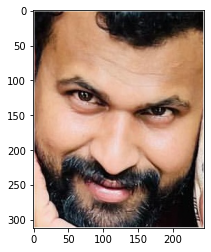

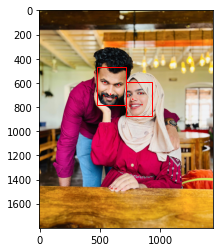

Face  0 emotion [2]
Face  1 emotion [0]
[2, 0]
Dominant emotion:  2
5
1/1 [==============================] - 0s 166ms/step
actual 2 predicted: 1


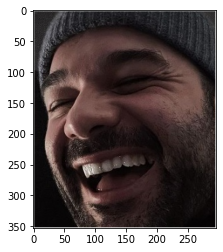

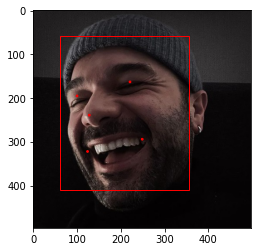

Face  0 emotion [2]
[2]
Dominant emotion:  2
6
2/2 [==============================] - 0s 6ms/step
actual 2 predicted: 1


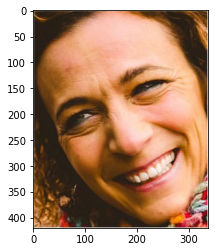

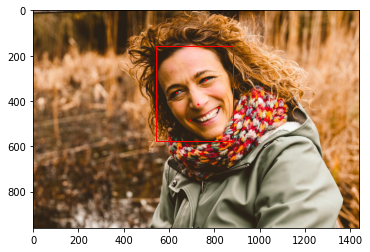

Face  0 emotion [2]
[2]
Dominant emotion:  2
7
1/1 [==============================] - 0s 172ms/step
actual 2 predicted: 1


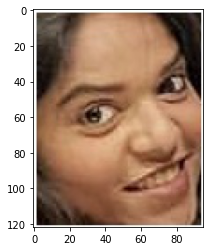

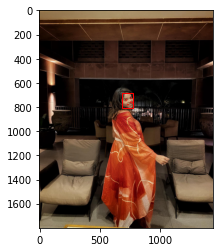

Face  0 emotion [0]
[0]
Dominant emotion:  0
7
1/1 [==============================] - 0s 174ms/step
actual 2 predicted: 1


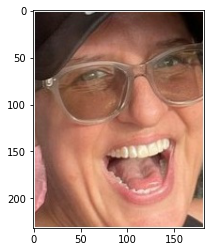

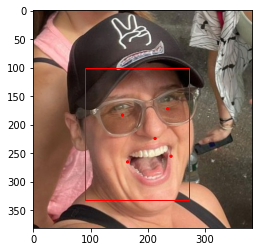

Face  0 emotion [2]
[2]
Dominant emotion:  2
8
1/1 [==============================] - 0s 158ms/step
actual 2 predicted: 1


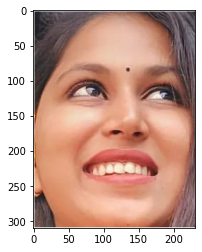

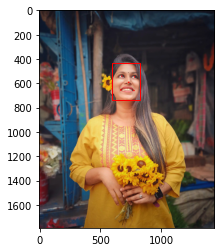

Face  0 emotion [2]
[2]
Dominant emotion:  2
9
1/1 [==============================] - 0s 160ms/step
actual 2 predicted: 1


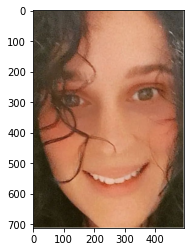

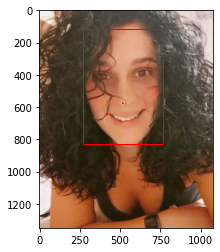

Face  0 emotion [2]
[2]
Dominant emotion:  2
10
1/1 [==============================] - 0s 168ms/step
actual 2 predicted: 1


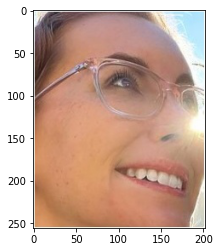

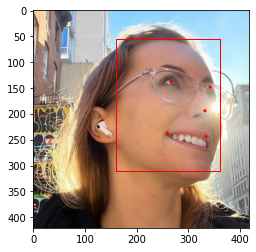

Face  0 emotion [2]
[2]
Dominant emotion:  2
11
1/1 [==============================] - 0s 185ms/step
actual 2 predicted: 1


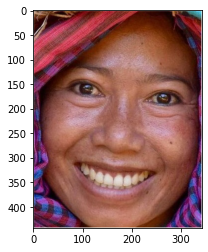

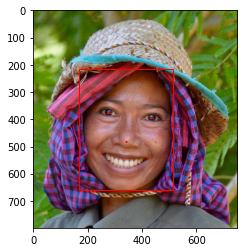

Face  0 emotion [2]
[2]
Dominant emotion:  2
12
1/1 [==============================] - 0s 171ms/step
actual 2 predicted: 1


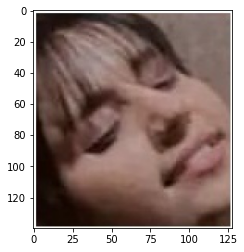

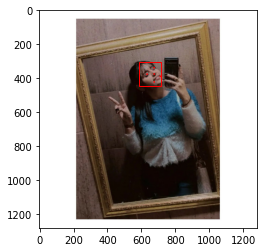

Face  0 emotion [3]
[3]
Dominant emotion:  3
12
1/1 [==============================] - 0s 152ms/step
actual 2 predicted: 1


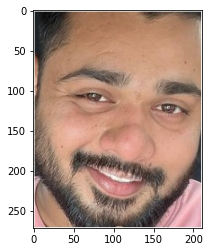

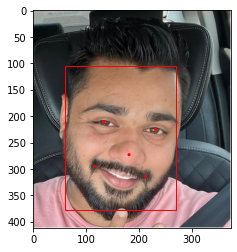

Face  0 emotion [2]
[2]
Dominant emotion:  2
13
1/1 [==============================] - 0s 151ms/step
actual 2 predicted: 1


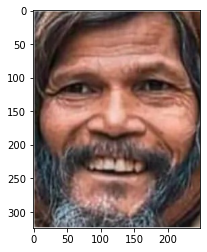

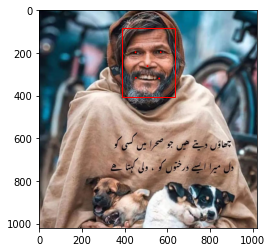

Face  0 emotion [2]
[2]
Dominant emotion:  2
14
2/2 [==============================] - 0s 7ms/step
actual 2 predicted: 1


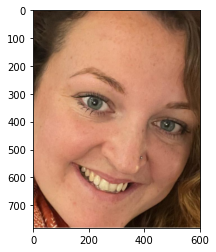

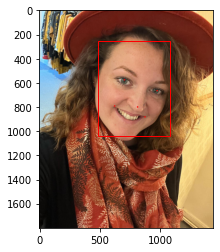

Face  0 emotion [2]
[2]
Dominant emotion:  2
15
1/1 [==============================] - 0s 165ms/step
actual 2 predicted: 3


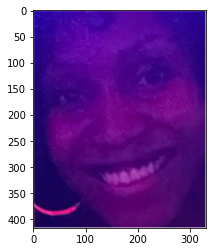

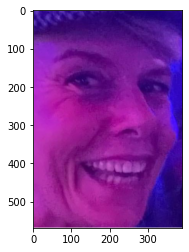

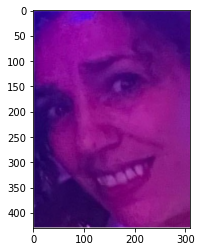

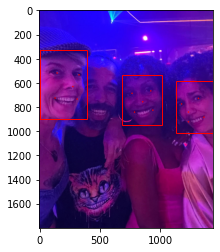

Face  0 emotion [2]
Face  1 emotion [2]
Face  2 emotion [2]
[2, 2, 2]
Dominant emotion:  2
16
1/1 [==============================] - 0s 205ms/step
actual 2 predicted: 1


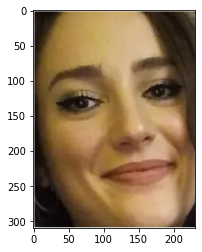

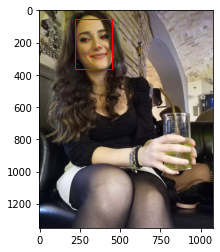

Face  0 emotion [2]
[2]
Dominant emotion:  2
17
1/1 [==============================] - 0s 203ms/step
actual 2 predicted: 1


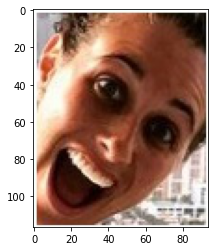

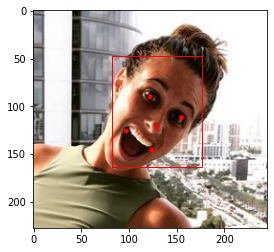

Face  0 emotion [2]
[2]
Dominant emotion:  2
18
19/19 [==============================] - 0s 3ms/step


In [ ]:
emotions= ['Angry', 'Fear', 'Happy', 'Neutral']
batch = []
predictions = []
matches = []
total_size = 0

for emotion in range(len(emotions)):
  print(emotions[emotion])
  folderPath = 'test_images_raw/' + emotions[emotion]
  dir_list = os.listdir(folderPath)
  size = len(dir_list)
  total_size += size
  matches.append(emotion_detector(folderPath, dir_list, emotion))